# Importing Libraries

In [ ]:
!pip install basemap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 936.0/936.0 kB 11.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.5/30.5 MB 39.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.0/53.0 kB 4.8 MB/s eta 0:00:00
  Attempting uninstall: packaging
    Found existing installation: packaging 24.0
    Uninstalling packaging-24.0:
      Successfully uninstalled packaging-24.0


In [ ]:
import numpy as np
import pandas as pd
import networkx as nx
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from sklearn.metrics.pairwise import cosine_similarity

from plotly.subplots import make_subplots
from networkx.algorithms import community

# Reading the Dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
filename = '/content/drive/My Drive/EECS6414/GlobalWeatherRepository.csv'
df = pd.read_csv(filename)
print(df.shape)
df.head()

(34309, 41)


,country,location_name,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,condition_text,...,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination
0,Afghanistan,Kabul,34.52,69.18,Asia/Kabul,1693301400,2023-08-29 14:00,28.8,83.8,Sunny,...,7.9,11.1,1,1,05:24 AM,06:24 PM,05:39 PM,02:48 AM,Waxing Gibbous,93
1,Albania,Tirana,41.33,19.82,Europe/Tirane,1693301400,2023-08-29 11:30,27.0,80.6,Partly cloudy,...,28.2,29.6,2,3,06:04 AM,07:19 PM,06:50 PM,03:25 AM,Waxing Gibbous,93
2,Algeria,Algiers,36.76,3.05,Africa/Algiers,1693301400,2023-08-29 10:30,28.0,82.4,Partly cloudy,...,6.4,7.9,1,1,06:16 AM,07:21 PM,06:46 PM,03:50 AM,Waxing Gibbous,93
3,Andorra,Andorra La Vella,42.50,1.52,Europe/Andorra,1693301400,2023-08-29 11:30,10.2,50.4,Sunny,...,0.5,0.8,1,1,07:16 AM,08:34 PM,08:08 PM,04:38 AM,Waxing Gibbous,93
4,Angola,Luanda,-8.84,13.23,Africa/Luanda,1693301400,2023-08-29 10:30,25.0,77.0,Partly cloudy,...,139.6,203.3,4,10,06:11 AM,06:06 PM,04:43 PM,04:41 AM,Waxing Gibbous,93


# Exploring and Cleaning the Data

## Unique Country

In [ ]:
uniq_country = df['country'].unique()
print(len(uniq_country))
uniq_country

185


array(['Afghanistan', 'Albania', 'Algeria', 'Andorra', 'Angola',
       'Antigua and Barbuda', 'Argentina', 'Armenia', 'Australia',
       'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh',
       'Barbados', 'Belarus', 'Belgium', 'Belize', 'Benin', 'Bhutan',
       'Bolivia', 'Bosnia and Herzegovina', 'Botswana', 'Brazil',
       'Brunei Darussalam', 'Bulgaria', 'Burkina Faso', 'Burundi',
       'Madagascar', 'Cape Verde', 'Cambodia', 'Cameroon', 'Canada',
       'Central African Republic', 'Chad', 'Chile', 'China', 'Comoros',
       'Congo', 'Costa Rica', 'Croatia', 'Cuba', 'Cyprus',
       'Czech Republic', 'Democratic Republic of Congo', 'Denmark',
       'Djibouti', 'Dominica', 'Dominican Republic', 'Ecuador', 'Egypt',
       'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia',
       'Swaziland', 'Ethiopia', 'Fiji Islands', 'Finland', 'France',
       'Gabon', 'Gambia', 'Georgia', 'Germany', 'Ghana', 'Greece',
       'Grenada', 'Guatemala', 'Guinea', 'Guinea-Bissau

## Unique Locations

In [ ]:
uniq_location = df['location_name'].unique()
print(len(uniq_location))
uniq_location

220


array(['Kabul', 'Tirana', 'Algiers', 'Andorra La Vella', 'Luanda',
       "Saint John's", 'Buenos Aires', 'Yerevan', 'Canberra', 'Vienna',
       'Baku', 'Nassau', 'Manama', 'Dhaka', 'Bridgetown', 'Minsk',
       'Brussels', 'Belmopan', 'Porto-Novo', 'Thimphu', 'Sucre',
       'Sarajevo', 'Gaborone', 'Bras', 'Bandar Seri Begawan', 'Sofia',
       'Ouagadougou', 'Bujumbura', 'Ivory', 'Praia', 'Phnom Penh',
       'Bafoussam', 'Ottawa', 'Bangui', "N'djamena", 'Santiago',
       'Beijing', 'Bogot', 'Moroni', 'Brazzaville', 'San Juan', 'Zagreb',
       'Havana', 'Nicosia', 'Prague', 'Kinshasa', 'Copenhagen',
       'Djibouti', 'Roseau', 'Santo Domingo', 'Quito', 'Cairo',
       'San Salvador', 'Malabo', 'Asmara', 'Tallinn', 'Mbabane',
       'Addis Ababa', 'Suva', 'Helsinki', 'Paris', 'Libreville', 'Banjul',
       'Tbilisi', 'Berlin', 'Accra', 'Athens', "Saint George's",
       'Guatemala City', 'Conakry', 'Bissau', 'Georgetown',
       'Port-Au-Prince', 'Vatican City', 'Tegucigalpa', 'Bu

## Adding Continent

In [ ]:
country_to_continent = {
'Afghanistan': 'Asia',
'Albania': 'Europe',
'Algeria': 'Africa',
'Andorra': 'Europe',
'Angola': 'Africa',
'Antigua and Barbuda': 'North America',
'Argentina': 'South America',
'Armenia': 'Asia',
'Australia': 'Australia',
'Austria': 'Europe',
'Azerbaijan': 'Asia',
'Bahamas': 'North America',
'Bahrain': 'Asia',
'Bangladesh': 'Asia',
'Barbados': 'North America',
'Belarus': 'Europe',
'Belgium': 'Europe',
'Belize': 'North America',
'Benin': 'Africa',
'Bhutan': 'Asia',
'Bolivia': 'South America',
'Bosnia and Herzegovina': 'Europe',
'Botswana': 'Africa',
'Brazil': 'South America',
'Brunei Darussalam': 'Asia',
'Bulgaria': 'Europe',
'Burkina Faso': 'Africa',
'Burundi': 'Africa',
'Madagascar': 'Africa',
'Cape Verde': 'Africa',
'Cambodia': 'Asia',
'Cameroon': 'Africa',
'Canada': 'North America',
'Central African Republic': 'Africa',
'Chad': 'Africa',
'Chile': 'South America',
'China': 'Asia',
'Comoros': 'Africa',
'Congo': 'Africa',
'Costa Rica': 'North America',
'Croatia': 'Europe',
'Cuba': 'North America',
'Cyprus': 'Asia',
'Czech Republic': 'Europe',
'Democratic Republic of Congo': 'Africa',
'Denmark': 'Europe',
'Djibouti': 'Africa',
'Dominica': 'North America',
'Dominican Republic': 'North America',
'Ecuador': 'South America',
'Egypt': 'Africa',
'El Salvador': 'North America',
'Equatorial Guinea': 'Africa',
'Eritrea': 'Africa',
'Estonia': 'Europe',
'Swaziland': 'Africa',
'Ethiopia': 'Africa',
'Fiji Islands': 'Australia',
'Finland': 'Europe',
'France': 'Europe',
'Gabon': 'Africa',
'Gambia': 'Africa',
'Georgia': 'Asia',
'Germany': 'Europe',
'Ghana': 'Africa',
'Greece': 'Europe',
'Grenada': 'North America',
'Guatemala': 'North America',
'Guinea': 'Africa',
'Guinea-Bissau': 'Africa',
'Guyana': 'South America',
'Haiti': 'North America',
'Vatican City': 'Europe',
'Honduras': 'North America',
'Hungary': 'Europe',
'Iceland': 'Europe',
'India': 'Asia',
'Indonesia': 'Asia',
'Iran': 'Asia',
'Iraq': 'Asia',
'Ireland': 'Europe',
'Israel': 'Asia',
'Italy': 'Europe',
'Jamaica': 'North America',
'Japan': 'Asia',
'Jordan': 'Asia',
'Kazakhstan': 'Asia',
'Kenya': 'Africa',
'Kiribati': 'Australia',
'Kuwait': 'Asia',
'Kyrghyzstan': 'Asia',
'Latvia': 'Europe',
'Lebanon': 'Asia',
'Lesotho': 'Africa',
'Liberia': 'Africa',
'Thailand': 'Asia',
'Liechtenstein': 'Europe',
'Lithuania': 'Europe',
'Luxembourg': 'Europe',
'Malawi': 'Africa',
'Malaysia': 'Asia',
'Maldives': 'Asia',
'Mali': 'Africa',
'Malta': 'Europe',
'Marshall Islands': 'Australia',
'Mauritania': 'Africa',
'Mauritius': 'Africa',
'Mexico': 'North America',
'Micronesia': 'Australia',
'Russia': 'Europe',
'Monaco': 'Europe',
'Mongolia': 'Asia',
'Montenegro': 'Europe',
'Morocco': 'Africa',
'Mozambique': 'Africa',
'Myanmar': 'Asia',
'Namibia': 'Africa',
'Turkey': 'Asia',
'Nepal': 'Asia',
'Netherlands': 'Europe',
'New Zealand': 'Australia',
'Nicaragua': 'North America',
'Niger': 'Africa',
'Nigeria': 'Africa',
'North Korea': 'Asia',
'Macedonia': 'Europe',
'Norway': 'Europe',
'Oman': 'Asia',
'Pakistan': 'Asia',
'Palau': 'Australia',
'Panama': 'North America',
'Papua New Guinea': 'Australia',
'Paraguay': 'South America',
'Peru': 'South America',
'Philippines': 'Asia',
'Poland': 'Europe',
'Portugal': 'Europe',
'Qatar': 'Asia',
'Romania': 'Europe',
'Rwanda': 'Africa',
'Saint Kitts and Nevis': 'North America',
'Saint Lucia': 'North America',
'Saint Vincent and the Grenadines': 'North America',
'Samoa': 'Australia',
'San Marino': 'Europe',
'Saudi Arabia': 'Asia',
'Senegal': 'Africa',
'Serbia': 'Europe',
'Seychelles Islands': 'Africa',
'Sierra Leone': 'Africa',
'Singapore': 'Asia',
'Slovakia': 'Europe',
'Slovenia': 'Europe',
'Solomon Islands': 'Australia',
'Somalia': 'Africa',
'South Africa': 'Africa',
'South Korea': 'Asia',
'Sudan': 'Africa',
'Spain': 'Europe',
'Sri Lanka': 'Asia',
'Suriname': 'South America',
'Sweden': 'Europe',
'Switzerland': 'Europe',
'Syria': 'Asia',
'Tajikistan': 'Asia',
'Tanzania': 'Africa',
'Tonga': 'Australia',
'Trinidad and Tobago': 'North America',
'Tunisia': 'Africa',
'Turkmenistan': 'Asia',
'Tuvalu': 'Australia',
'Uganda': 'Africa',
'Ukraine': 'Europe',
'United Arab Emirates': 'Asia',
'United Kingdom': 'Europe',
'United States of America': 'North America',
'Uruguay': 'South America',
'Uzbekistan': 'Asia',
'Vanuatu': 'Australia',
'Venezuela': 'South America',
'Vietnam': 'Asia',
'Yemen': 'Asia',
'Zambia': 'Africa',
'Zimbabwe': 'Africa',
'Timor-Leste': 'Asia'
}

df['continent'] = df['country'].map(country_to_continent)

## Dropping Redundant Columns

In [ ]:
df.drop(['timezone', 'last_updated_epoch', 'temperature_fahrenheit', 'wind_mph', 'pressure_in', 'precip_in', 'feels_like_fahrenheit', 'visibility_miles', 'gust_mph'], axis = 1, inplace = True)

In [ ]:
print(df.shape)
df.head()

(34309, 33)


,country,location_name,latitude,longitude,last_updated,temperature_celsius,condition_text,wind_kph,wind_degree,wind_direction,...,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination,continent
0,Afghanistan,Kabul,34.52,69.18,2023-08-29 14:00,28.8,Sunny,11.5,74,ENE,...,11.1,1,1,05:24 AM,06:24 PM,05:39 PM,02:48 AM,Waxing Gibbous,93,Asia
1,Albania,Tirana,41.33,19.82,2023-08-29 11:30,27.0,Partly cloudy,6.1,210,SSW,...,29.6,2,3,06:04 AM,07:19 PM,06:50 PM,03:25 AM,Waxing Gibbous,93,Europe
2,Algeria,Algiers,36.76,3.05,2023-08-29 10:30,28.0,Partly cloudy,13.0,240,WSW,...,7.9,1,1,06:16 AM,07:21 PM,06:46 PM,03:50 AM,Waxing Gibbous,93,Africa
3,Andorra,Andorra La Vella,42.50,1.52,2023-08-29 11:30,10.2,Sunny,9.7,345,NNW,...,0.8,1,1,07:16 AM,08:34 PM,08:08 PM,04:38 AM,Waxing Gibbous,93,Europe
4,Angola,Luanda,-8.84,13.23,2023-08-29 10:30,25.0,Partly cloudy,3.6,270,W,...,203.3,4,10,06:11 AM,06:06 PM,04:43 PM,04:41 AM,Waxing Gibbous,93,Africa


# Visualizing Relationships between different attributes

## Interactive Global Temperature Heat Map

In [ ]:
mapbox_plot = px.scatter_mapbox(df, lat='latitude', lon='longitude', hover_name='location_name', color='temperature_celsius', title='Interactive Global Temperature Heat Map')
mapbox_plot.update_layout(mapbox_style='open-street-map')

mapbox_plot.update_layout(
    autosize=False,
    width=1500,
    height=800,
)

mapbox_plot.show()

In [ ]:
# Create an interactive temperature heatmap using Plotly Express
fig = px.scatter_geo(
    df,
    lat='latitude',
    lon='longitude',
    color='temperature_celsius',
    hover_name='location_name',
    projection='natural earth',  # Adjust the projection as needed
    title='Interactive Global Temperature Heatmap',
)

fig.update_geos(showcoastlines=True, coastlinecolor="Black", showland=True, landcolor="white", showocean = True)

fig.update_layout(
    autosize=False,
    width=1000,
    height=800,
)

# Show the interactive map
fig.show()

## Average Temperature

### Country-Wise

In [ ]:
bar_chart = px.bar(df, x='country', y='temperature_celsius', title='Average Temperature by Country')
bar_chart.show()

In [ ]:
# Group the data by country and calculate the average temperature
avg_temp_by_country = df.groupby('country')['temperature_celsius'].mean().reset_index()

# Create a bar chart of average temperature by continent
fig = px.bar(avg_temp_by_country, x='country', y='temperature_celsius',
             title='Average Temperature by Country',
             color_discrete_sequence=px.colors.qualitative.Pastel1)

# Display the bar chart
fig.show()

### Continent-Wise

In [ ]:
bar_chart = px.bar(df, x='continent', y='temperature_celsius', title='Average Temperature by Continent')
bar_chart.show()

In [ ]:
# Group the data by continent and calculate the average temperature
avg_temp_by_continent = df.groupby('continent')['temperature_celsius'].mean().reset_index()

# Create a bar chart of average temperature by continent
fig = px.bar(avg_temp_by_continent, x='continent', y='temperature_celsius',
             title='Average Temperature by Continent',
             color_discrete_sequence=px.colors.qualitative.Pastel1)

# Display the bar chart
fig.show()

### Top-10 and Bottom-10 Locations

In [ ]:
# Create a list of all unique city names
cities = df['location_name'].unique()

# Initialize dictionaries to store the maximum and minimum temperatures for each city
max_temperatures = {}
min_temperatures = {}

# Iterate through the cities and calculate the maximum and minimum temperatures
for city in cities:
    city_data = df[df['location_name'] == city]
    max_temp = city_data['temperature_celsius'].max()
    min_temp = city_data['temperature_celsius'].min()
    max_temperatures[city] = max_temp
    min_temperatures[city] = min_temp

# Sort the cities by maximum and minimum temperatures
top_10_max = sorted(max_temperatures.items(), key=lambda x: x[1], reverse=True)[:10]
bottom_10_min = sorted(min_temperatures.items(), key=lambda x: x[1])[:10]

# Create dynamic visualizations using Plotly
def create_bar_chart(data, title, color):
    fig = px.bar(data, x='City', y='Temperature (°C)', title=title)
    fig.update_traces(marker_color=color, marker_line_color='black', marker_line_width=1)
    fig.update_xaxes(categoryorder='total ascending')
    return fig

# Define custom colors for the bars
top_chart_color = 'rgb(75, 136, 230)'  # Blue
bottom_chart_color = 'rgb(255, 87, 51)'  # Red

# Create interactive bar charts for the top 10 and bottom 10 cities with custom colors
top_10_max_df = pd.DataFrame(top_10_max, columns=['City', 'Temperature (°C)'])
bottom_10_min_df = pd.DataFrame(bottom_10_min, columns=['City', 'Temperature (°C)'])

top_chart = create_bar_chart(top_10_max_df, 'Top 10 Cities by Maximum Temperature', top_chart_color)
bottom_chart = create_bar_chart(bottom_10_min_df, 'Bottom 10 Cities by Minimum Temperature', bottom_chart_color)

# Display the interactive charts side by side
fig = make_subplots(rows=1, cols=2, subplot_titles=('Top 10 Cities', 'Bottom 10 Cities'))
fig.add_trace(top_chart.data[0], row=1, col=1)
fig.add_trace(bottom_chart.data[0], row=1, col=2)

fig.update_layout(showlegend=False)

fig.update_layout(
    autosize=False,
    width=1000,
    height=500,
)

fig.show()

## Temperature vs Humidity

### Country-Wise

In [ ]:
scatter_plot = px.scatter(df, x='temperature_celsius', y='humidity', color='country', title='Temperature vs Humidity')
scatter_plot.show()

### Continent-Wise

In [ ]:
scatter_plot = px.scatter(df, x='temperature_celsius', y='humidity', color='continent', title='Temperature vs Humidity')
scatter_plot.show()

## Temperature vs Humidity vs Wind

### Country-Wise

In [ ]:
scatter_3d = px.scatter_3d(df, x='temperature_celsius', y='humidity', z='wind_kph', color='country', title='3D Scatter Plot of Temperature vs Humidity vs Wind')
scatter_3d.show()

### Continent-Wise

In [ ]:
scatter_3d = px.scatter_3d(df, x='temperature_celsius', y='humidity', z='wind_kph', color='continent', title='3D Scatter Plot of Temperature vs Humidity vs Wind')
scatter_3d.show()

## Wind Speed by Direction

### Country-Wise

In [ ]:
polar_scatter = px.scatter_polar(df, r='wind_kph', theta='wind_direction', color='country', title='Wind Speed by Direction')
polar_scatter.update_layout(
    autosize=False,
    width=800,
    height=500,
)
polar_scatter.show()

### Continent-Wise

In [ ]:
polar_scatter = px.scatter_polar(df, r='wind_kph', theta='wind_direction', color='continent', title='Wind Speed by Direction')
polar_scatter.update_layout(
    autosize=False,
    width=800,
    height=500,
)
polar_scatter.show()

## Temperature by Wind Direction (Polar Bar)

### Country-Wise

In [ ]:
polar_bar = px.bar_polar(df, r='temperature_celsius', theta='wind_direction', color='country', title='Temperature by Wind Direction (Polar Bar)')
polar_bar.show()

### Continent-Wise

In [ ]:
polar_bar = px.bar_polar(df, r='temperature_celsius', theta='wind_direction', color='continent', title='Temperature by Wind Direction (Polar Bar)')
polar_bar.show()

## Air Quality Index vs Rain Precipitation

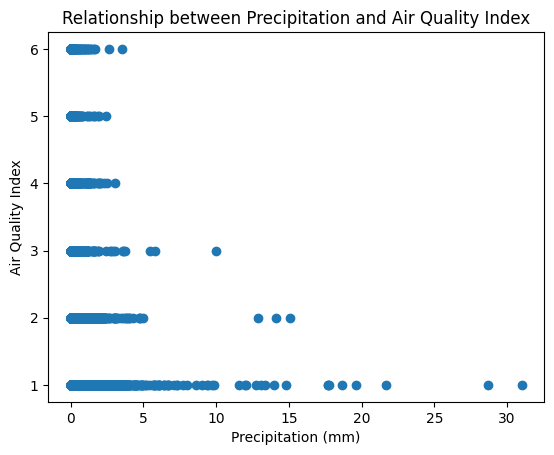

In [ ]:
plt.scatter(df['precip_mm'], df['air_quality_us-epa-index'])
plt.xlabel('Precipitation (mm)')
plt.ylabel('Air Quality Index')
plt.title('Relationship between Precipitation and Air Quality Index')
plt.show()

# Designing Networks

## Location as Nodes and Spatial Distance between locations as Edges

In [ ]:
df_uniq_location = df.drop_duplicates(subset=['location_name'])
df_uniq_location.shape

(220, 33)

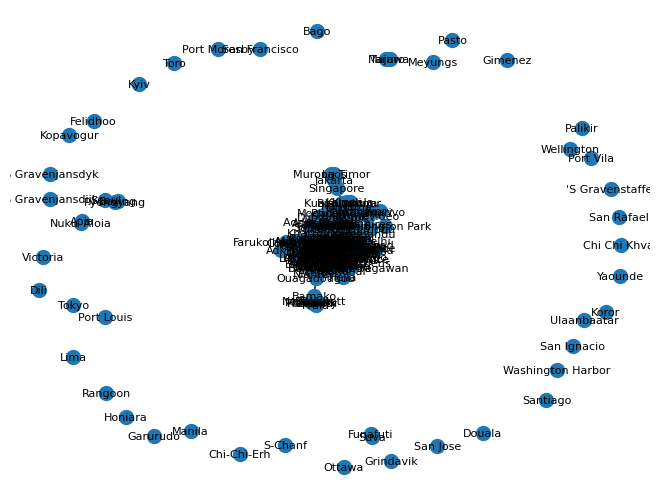

<Figure size 960x800 with 0 Axes>

In [ ]:
# Create an empty graph
G = nx.Graph()

# Add nodes to the graph with location names
G.add_nodes_from(df_uniq_location['location_name'])

# Assuming you want to connect nodes based on geographical proximity
for i in range(len(df_uniq_location)):
    for j in range(i + 1, len(df_uniq_location)):
        # Calculate distance (you might need a more sophisticated distance metric)
        distance = ((df_uniq_location.iloc[i]['latitude'] - df_uniq_location.iloc[j]['latitude']) ** 2 + (df_uniq_location.iloc[i]['longitude'] - df_uniq_location.iloc[j]['longitude']) ** 2) ** 0.5

        # Add an edge if the distance is below a certain threshold (customize as needed)
        if distance <= 10:  # If Distance is less than 10, join them with an edge.
            G.add_edge(df.iloc[i]['location_name'], df.iloc[j]['location_name'], weight=distance)

# Visualize the graph
pos = nx.spring_layout(G)  # You can use different layouts based on preferences

# Draw nodes and edges
nx.draw(G, pos, with_labels=True, font_size=8, node_size=100, font_color='black')

# Display the graph
plt.figure(figsize=(12, 10), dpi=80)
plt.show()

### Graph Properties

In [ ]:
num_nodes = G.number_of_nodes()
num_edges = G.number_of_edges()
print(f"Number of nodes: {num_nodes}")
print(f"Number of edges: {num_edges}")

density = nx.density(G)
print(f"Graph density: {density}")

num_components = nx.number_connected_components(G)
components = list(nx.connected_components(G))
print(f"Number of connected components: {num_components}")
print(f"Connected components: {components}")

node_degrees = dict(G.degree())
degree_histogram = nx.degree_histogram(G)
print(f"Node degrees: {node_degrees}")
print(f"Degree histogram: {degree_histogram}")

avg_clustering = nx.average_clustering(G)
print(f"Average clustering coefficient: {avg_clustering}")

# Since graph is not connected, there is infite path length.

# average_shortest_path_length = nx.average_shortest_path_length(G)
# print("Average shortest path length:", average_shortest_path_length)

# diameter = nx.diameter(G)
# print(f"Graph diameter: {diameter}")

Number of nodes: 220
Number of edges: 779
Graph density: 0.032337069323370694
Number of connected components: 44
Connected components: [{'Helsinki', 'Paramaribo', 'Nicosia', 'Pretoria', 'Vatican City', 'Mexico City', 'Quito', 'Dodoma', 'Kinshasa', 'Kathmandu', 'Maputo', 'San Juan', 'Brussels', 'Bratislava', 'Addis Ababa', 'Skopje', 'Amman', 'Georgetown', 'Hella', 'Farukolhufunadhoo', 'Damascus', 'Dakar', 'New Delhi', 'Sofia', 'Port Of Spain', 'Tirana', 'Kigali', 'Luxembourg', 'Juba', 'Niamey', "Saint George's", 'Bangui', 'Bridgetown', 'Moroni', 'Basseterre', 'Pathein', 'Lom', 'Maseru', 'Vaduz', 'Nassau', 'Laos', 'Jerusalem', 'Riga', 'Roseau', 'Khartoum', 'Warsaw', 'Praia', 'Oslo', 'Havana', 'Ashgabat', 'Bandar Seri Begawan', 'Canberra', 'Monaco', 'Freetown', 'Conakry', 'San Marino', 'Kuwait City', 'San Salvador', 'Abu Dhabi', 'Dhaka', 'Ankara', 'Mbabane', 'Manama', 'Nouakchott', 'Luanda', 'Hanoi', 'Lilongwe', 'Windhoek', 'Bucharest', 'Nairobi', 'Baghdad', 'Bogot', 'Thimphu', 'Murong Ti

### Visualize components with more than 2 nodes

No of Nodes:  172


/usr/local/lib/python3.10/dist-packages/networkx/drawing/nx_pylab.py:437: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

<ipython-input-29-3d73c45b83c4>:32: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



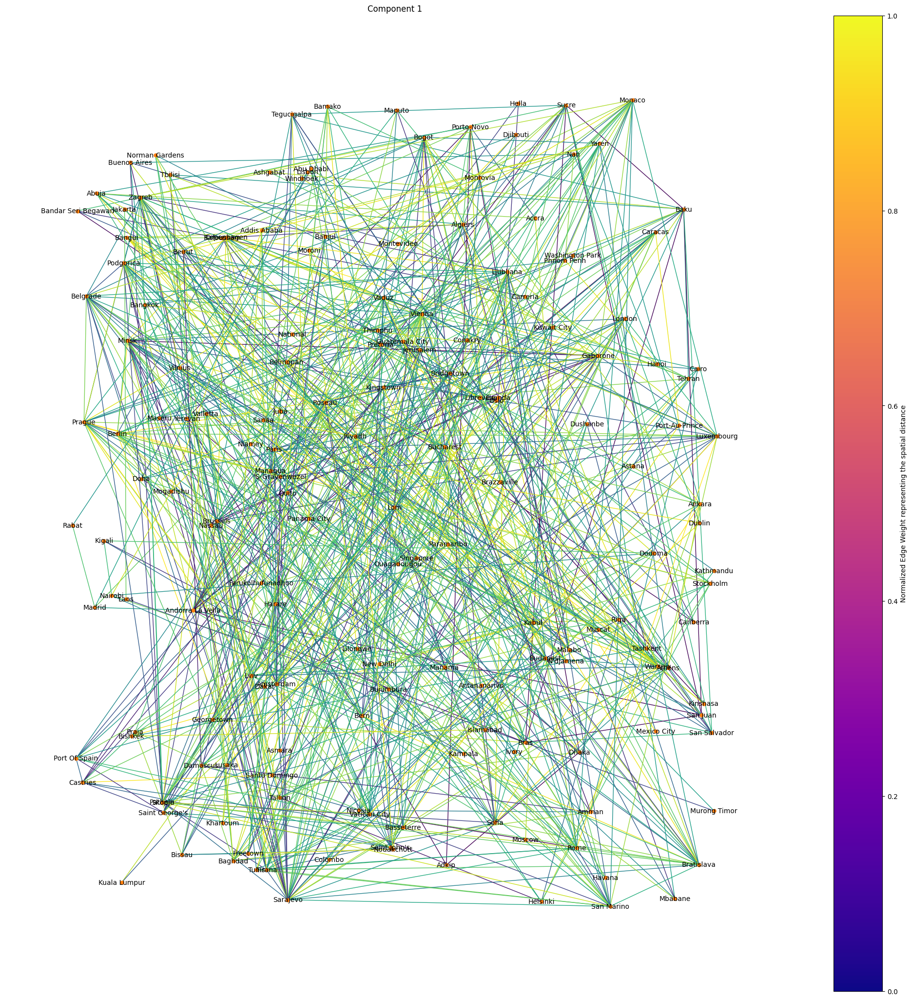

No of Nodes:  3


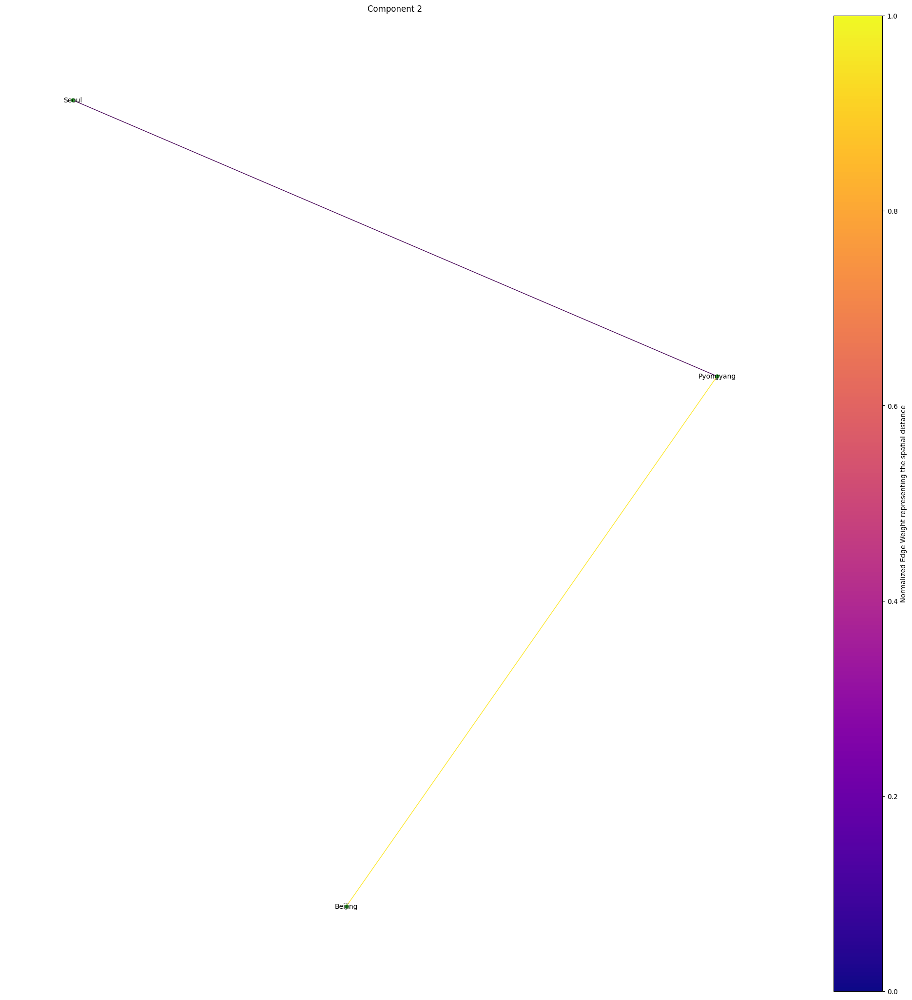

In [ ]:
# Identify connected components
components = list(nx.connected_components(G))
i = 0

# Visualize each component separately
for component in components:
    n_nodes = len(component)
    if n_nodes > 2:
        print("No of Nodes: ", n_nodes)
        subgraph = G.subgraph(component)
        i += 1

        # Get edge weights
        edge_weights = [subgraph[u][v]['weight'] for u, v in subgraph.edges()]

        # Normalize edge weights between 0 and 1
        min_weight = min(edge_weights)
        max_weight = max(edge_weights)

        norm_edge_weights = [(w - min_weight) / (max_weight - min_weight) for w in edge_weights]

        # Create colormap based on edge weights
        cmap = plt.cm.plasma

        # Visualize the subgraph
        pos = nx.random_layout(subgraph)  # You can use different layouts based on preferences

        plt.figure(figsize=(20, 20))
        nx.draw(subgraph, pos, with_labels=True, font_size=10, node_size=25, font_color='black', node_color=f"C{i}", edge_color=norm_edge_weights, cmap=cmap, width=1.0)
        plt.title(f"Component {i}")

        plt.colorbar(plt.cm.ScalarMappable(cmap=cmap), label='Normalized Edge Weight representing the spatial distance')
        plt.show()

### Centrality Measures

In [ ]:
# Calculate and print different centrality measures
print("Degree Centrality:")
degree_centrality = nx.degree_centrality(G)
print(degree_centrality)
print(sorted(degree_centrality, key = degree_centrality.get, reverse = True)[:5])

print("\nCloseness Centrality:")
closeness_centrality = nx.closeness_centrality(G)
print(closeness_centrality)
print(sorted(closeness_centrality, key = closeness_centrality.get, reverse = True)[:5])

print("\nBetweenness Centrality:")
betweenness_centrality = nx.betweenness_centrality(G)
print(betweenness_centrality)
print(sorted(betweenness_centrality, key = betweenness_centrality.get, reverse = True)[:5])

print("\nEigenvector Centrality:")
eigenvector_centrality = nx.eigenvector_centrality(G)
print(eigenvector_centrality)
print(sorted(eigenvector_centrality, key = eigenvector_centrality.get, reverse = True)[:5])

print("\nPageRank:")
pagerank = nx.pagerank(G)
print(pagerank)
print(sorted(pagerank, key = pagerank.get, reverse = True)[:5])

Degree Centrality:
{'Kabul': 0.0639269406392694, 'Tirana': 0.091324200913242, 'Algiers': 0.0547945205479452, 'Andorra La Vella': 0.1095890410958904, 'Luanda': 0.0228310502283105, "Saint John's": 0.0684931506849315, 'Buenos Aires': 0.0273972602739726, 'Yerevan': 0.0365296803652968, 'Canberra': 0.0182648401826484, 'Vienna': 0.1552511415525114, 'Baku': 0.0730593607305936, 'Nassau': 0.0273972602739726, 'Manama': 0.0410958904109589, 'Dhaka': 0.0365296803652968, 'Bridgetown': 0.0639269406392694, 'Minsk': 0.1050228310502283, 'Brussels': 0.091324200913242, 'Belmopan': 0.091324200913242, 'Porto-Novo': 0.0547945205479452, 'Thimphu': 0.0136986301369863, 'Sucre': 0.0684931506849315, 'Sarajevo': 0.1598173515981735, 'Gaborone': 0.1004566210045662, 'Bras': 0.0547945205479452, 'Bandar Seri Begawan': 0.0182648401826484, 'Sofia': 0.0821917808219178, 'Ouagadougou': 0.0228310502283105, 'Bujumbura': 0.0182648401826484, 'Ivory': 0.0045662100456621, 'Praia': 0.0182648401826484, 'Phnom Penh': 0.01826484018264

### Communities

#### Greedy Modularity

In [ ]:
communities = community.greedy_modularity_communities(G)
print("No. of Communities: ", len(communities))
communities

No. of Communities:  51


[frozenset({'Abuja',
            'Accra',
            'Algiers',
            'Andorra La Vella',
            'Bafoussam',
            'Bandar Seri Begawan',
            'Bangui',
            'Basseterre',
            'Belmopan',
            'Bras',
            'Brazzaville',
            'Bridgetown',
            'Canberra',
            'Caracas',
            'Carreria',
            'Castries',
            'Georgetown',
            'Guatemala City',
            'Havana',
            'Hella',
            'Kingstown',
            'Kinshasa',
            'Libreville',
            'Lisbon',
            'Luanda',
            'Madrid',
            'Malabo',
            'Managua',
            'Mexico City',
            "N'djamena",
            'Nassau',
            'National',
            'Niamey',
            'Norman Gardens',
            'Ouagadougou',
            'Panama City',
            'Paramaribo',
            'Port Of Spain',
            'Port-Au-Prince',
            'Porto-Novo',
   

#### Louvain

In [ ]:
partitions = community.louvain_communities(G)
num_communities = len(partitions)

print(f"Number of communities: {num_communities}")
partitions

Number of communities: 51


[{'Astana',
  'Bangkok',
  'Bishkek',
  'Buenos Aires',
  'Dhaka',
  'Dushanbe',
  'Hanoi',
  'Islamabad',
  'Jakarta',
  'Kathmandu',
  'Kuala Lumpur',
  'Laos',
  'Montevideo',
  'Murong Timor',
  'Nan',
  'New Delhi',
  'Pathein',
  'Phnom Penh',
  'Singapore',
  'Tashkent',
  'Thimphu',
  'Washington Park'},
 {'Ottawa'},
 {'Santiago'},
 {'Beijing', 'Pyongyang', 'Seoul'},
 {'Addis Ababa',
  'Antananarivo',
  'Asmara',
  'Bujumbura',
  'Djibouti',
  'Dodoma',
  'Gaborone',
  'Harare',
  'Ivory',
  'Kampala',
  'Khartoum',
  'Kigali',
  'Lilongwe',
  'Lusaka',
  'Maputo',
  'Maseru',
  'Mbabane',
  'Mogadishu',
  'Moroni',
  'Nairobi',
  'Pretoria',
  'Sanaa',
  'Windhoek'},
 {'Funafuti', 'Suva'},
 {'Abu Dhabi',
  'Adkip',
  'Amman',
  'Ankara',
  'Baghdad',
  'Beirut',
  'Cairo',
  'Colombo',
  'Damascus',
  'Doha',
  'Farukolhufunadhoo',
  'Jerusalem',
  'Kuwait City',
  'Manama',
  'Muscat',
  'Nicosia',
  'Riyadh',
  'Tbilisi',
  'Tehran',
  'Yerevan'},
 {'Ashgabat',
  'Baku',
  '

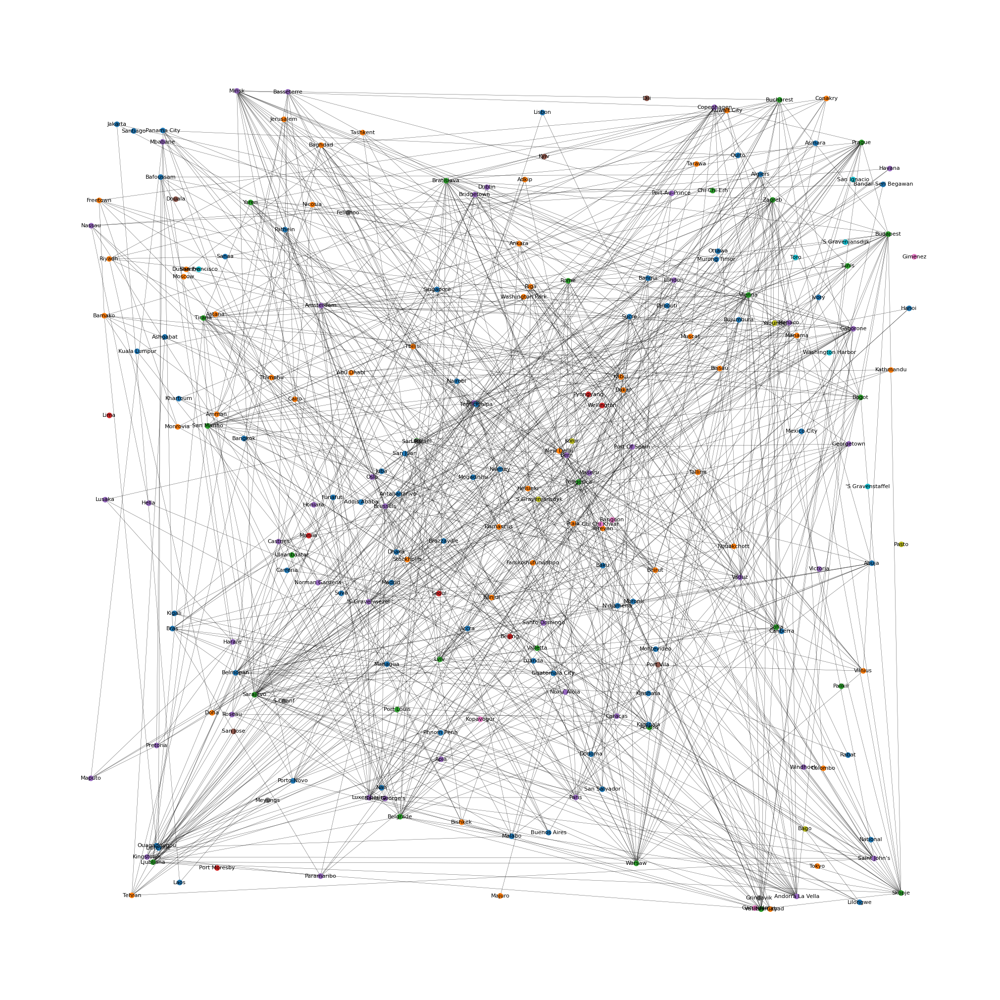

In [ ]:
pos = nx.random_layout(G)
colors = []
for node in G.nodes:
  for i, p in enumerate(partitions):
    if node in p:
      colors.append(i)
      break

plt.figure(figsize=(20, 20))

# Draw nodes and edges with community-based coloring
nx.draw(G, pos, with_labels=True, font_size=8, node_size=50, font_color='black', node_color=colors, cmap=plt.cm.tab10, width = 0.25)

# Display the graph
plt.show()

### Degree Distribution

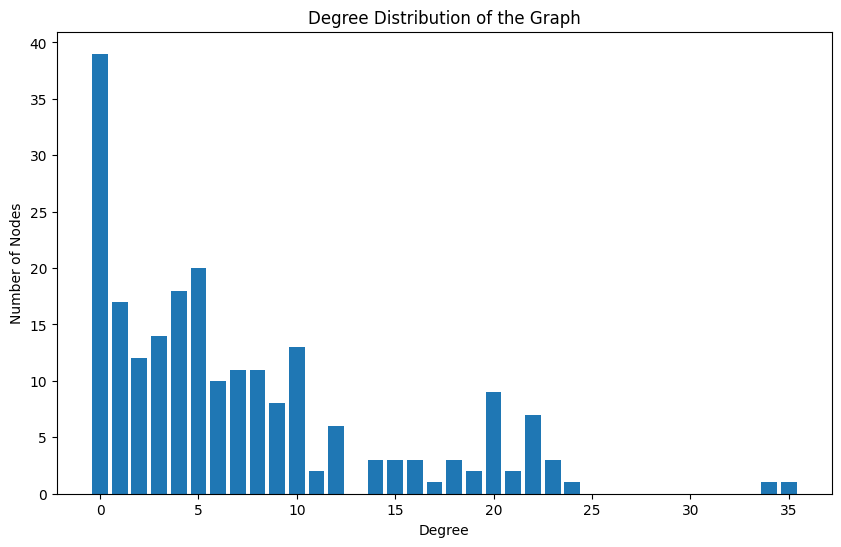

In [ ]:
# Calculate the degree distribution of the graph
degree_distribution = nx.degree_histogram(G)

# Plot the degree distribution
plt.figure(figsize=(10, 6))
plt.bar(range(len(degree_distribution)), degree_distribution)
plt.xlabel("Degree")
plt.ylabel("Number of Nodes")
plt.title("Degree Distribution of the Graph")
plt.show()

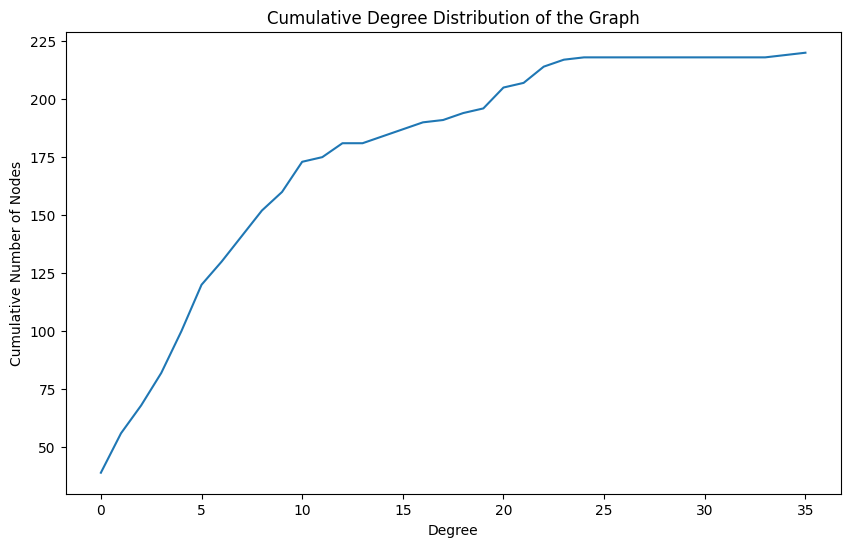

In [ ]:
# Calculate the cumulative degree distribution
cumulative_degree_distribution = np.cumsum(degree_distribution)

# Plot the cumulative degree distribution
plt.figure(figsize=(10, 6))
plt.plot(range(len(cumulative_degree_distribution)), cumulative_degree_distribution)
plt.xlabel("Degree")
plt.ylabel("Cumulative Number of Nodes")
plt.title("Cumulative Degree Distribution of the Graph")
plt.show()

### Correlation Analysis

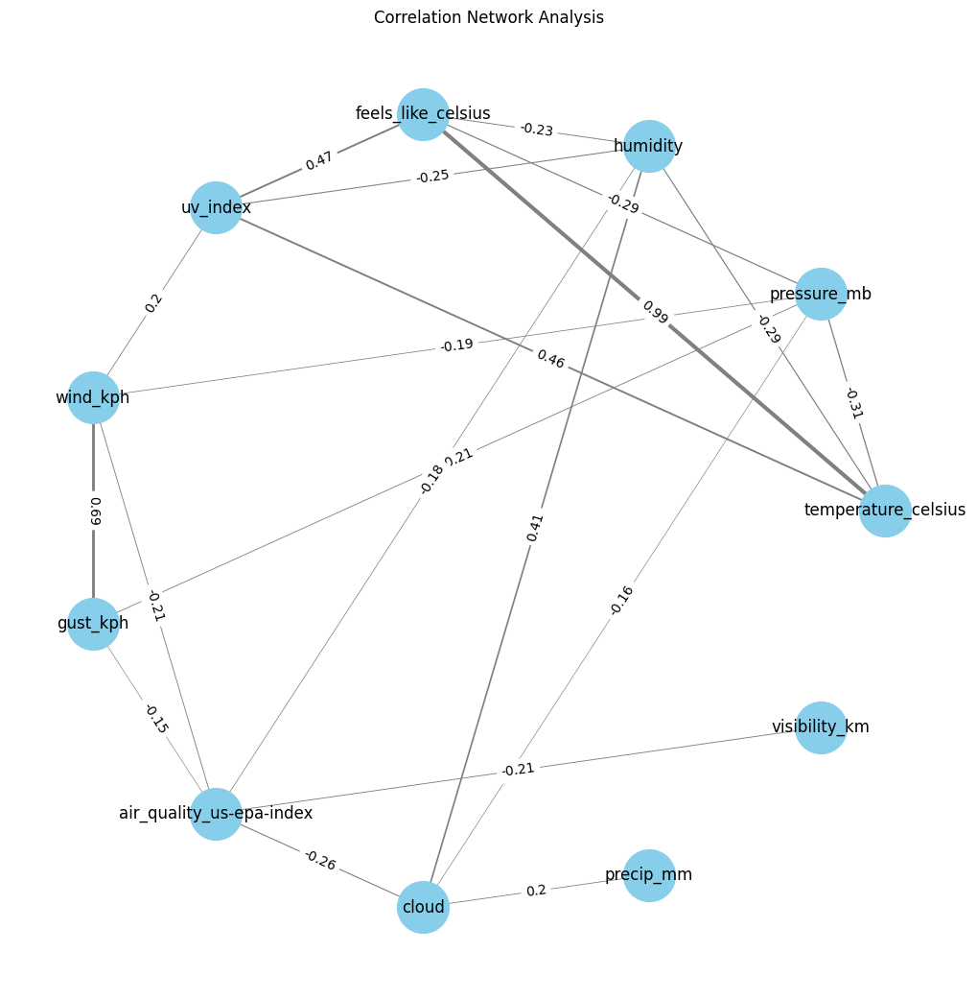

In [ ]:
# Select relevant weather variables for correlation analysis
weather_variables = ['temperature_celsius', 'wind_kph', 'pressure_mb', 'precip_mm', 'humidity', 'cloud', 'feels_like_celsius', 'visibility_km', 'uv_index', 'gust_kph', 'air_quality_us-epa-index']

# Calculate correlation matrix
correlation_matrix = df[weather_variables].corr()

# Threshold for significant correlation
threshold = 0.15  # Adjust as needed

# Create a graph for significant correlations
G = nx.Graph()
for i, var1 in enumerate(weather_variables):
    for j, var2 in enumerate(weather_variables):
        if i < j:
            correlation = correlation_matrix.loc[var1, var2]
            if abs(correlation) >= threshold:
                G.add_edge(var1, var2, weight=correlation)

# Draw the graph
pos = nx.circular_layout(G)
# pos = nx.planar_layout(G)
edges = G.edges()
weights = [abs(G[u][v]['weight']) * 3 for u, v in edges]
plt.figure(figsize=(10,10))
nx.draw(G, pos, with_labels=True, node_color='skyblue', node_size=1500, edge_color='gray', width=weights)
edge_labels = {(u, v): round(G[u][v]['weight'], 2) for u, v in edges}
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)
plt.title('Correlation Network Analysis')
plt.show()

## Rainfall Propagation Network

### Average over Entire Period

In [ ]:
def similarity_calculator(x, y):
    rainfall_thresh = 0.15
    if x <= rainfall_thresh and y <= rainfall_thresh:
        return 0
    if max(x, y):
        return (1 - abs((x - y)/max(x,y)))
    else:
        return 1

    # # Convert float values to numpy arrays
    # vector1 = np.array([value1]).reshape(1, -1)
    # vector2 = np.array([value2]).reshape(1, -1)

    # # Calculate cosine similarity
    # similarity_score = cosine_similarity(vector1, vector2)[0, 0]
    # print("Similarity Score: ", similarity_score, cosine_similarity(vector1, vector2), vector1, vector2 )

    # # The similarity score will be in the range [-1, 1]
    # # Map it to a range [0, 1], where higher values indicate more similarity
    # similarity_mapped = 0.5 + 0.5 * similarity_score

    # return similarity_mapped

In [ ]:
avg_rainfall_per_location_df = df.groupby('location_name').agg({'latitude': 'first',  # Assuming latitude is the same for all rows in a location
                                                                'longitude': 'first',  # Assuming longitude is the same for all rows in a location
                                                                'country': 'first',
                                                                'precip_mm': 'mean',
                                                            }).reset_index()

print(avg_rainfall_per_location_df.shape)
avg_rainfall_per_location_df.head()

(220, 5)


,location_name,latitude,longitude,country,precip_mm
0,'S Gravenjansdijk,51.25,3.63,Belgium,0.073333
1,'S Gravenjansdyk,51.25,3.63,Belgium,0.078333
2,'S Gravenstaffel,50.88,2.98,Belgium,0.011667
3,'S-Gravenwezel,51.27,4.55,Belgium,0.111022
4,Abu Dhabi,24.47,54.37,United Arab Emirates,0.000682


In [ ]:
# Define threshold for precipitation to consider it as rainfall
precipitation_similarity_threshold = 0.95  # Adjust as needed

# Create a directed graph
G = nx.DiGraph()

# Add nodes representing locations
locations = avg_rainfall_per_location_df['location_name'].unique()
for location in locations:
    G.add_node(location)

for i in range(len(avg_rainfall_per_location_df)):
    for j in range(i + 1, len(avg_rainfall_per_location_df)):
        source_location = avg_rainfall_per_location_df.iloc[i]['location_name']
        source_precipitation = avg_rainfall_per_location_df.iloc[i]['precip_mm']
        target_location = avg_rainfall_per_location_df.iloc[j]['location_name']
        target_precipitation = avg_rainfall_per_location_df.iloc[j]['precip_mm']

        wt = similarity_calculator(source_precipitation, target_precipitation)

        if wt >= precipitation_similarity_threshold:
            # Add directed edge from source to target representing rainfall propagation
            G.add_edge(source_location, target_location, weight = wt)

# Get edge weights
edge_weights = [G[u][v]['weight'] for u, v in G.edges()]
print(max(edge_weights), min(edge_weights))

# Normalize edge weights between 0 and 1
min_weight = min(edge_weights)
max_weight = max(edge_weights)

norm_edge_weights = [(w - min_weight) / (max_weight - min_weight) for w in edge_weights]

# Create colormap based on edge weights
cmap = plt.cm.plasma

# Visualize the subgraph
pos = nx.random_layout(G)  # Use different layouts

plt.figure(figsize=(12, 12))
nx.draw(G, pos, with_labels=True, font_size=9, node_size=25, font_color='black', node_color="orange", edge_color=norm_edge_weights, cmap=cmap, width=1.0)
plt.title('Rainfall Propagation Network')

plt.colorbar(plt.cm.ScalarMappable(cmap=cmap), label='Normalized Edge Weight representing the similarity in precipitation among different locations')
plt.show()

# # plt.figure(figsize=(12, 12))

# # # pos = {row['location_name']: (row['longitude'], row['latitude']) for index, row in avg_rainfall_per_location_df.iterrows()}
# # pos = nx.random_layout(G)

# # # Draw nodes and edges with community-based coloring
# # nx.draw(G, pos, with_labels=True, font_size=8, node_size=50, font_color='black', node_color='lightblue', cmap=plt.cm.tab10, width = 0.25)

# # # Display the graph
# # plt.show()

In [ ]:
# Retrieve connected nodes with their weights
connected_nodes_with_weights = []
for edge in G.edges(data=True):
    source = edge[0]
    target = edge[1]
    weight = edge[2]['weight']
    connected_nodes_with_weights.append((source, target, weight))

# Print connected nodes with their weights
for source, target, weight in connected_nodes_with_weights:
    print(f"From: {source}, To: {target}, Weight: {weight}")

In [ ]:
import matplotlib.pyplot as plt
import networkx as nx
from mpl_toolkits.basemap import Basemap

# Assuming you have latitude and longitude information for each location in avg_rainfall_per_location_df
precipitation_similarity_threshold = 0.98

# Increase figure size
plt.figure(figsize=(20, 16))

# Create a Basemap instance
m = Basemap(projection='merc',llcrnrlat=-80,urcrnrlat=80,\
            llcrnrlon=-180,urcrnrlon=180,lat_ts=20,resolution='c')

# Draw coastlines, countries, and states
m.drawcoastlines()
m.drawcountries()
m.drawstates()

# Create a directed graph
G = nx.DiGraph()

# Add nodes representing locations
locations = avg_rainfall_per_location_df['location_name'].unique()
for location in locations:
    G.add_node(location)

for i in range(len(avg_rainfall_per_location_df)):
    for j in range(i + 1, len(avg_rainfall_per_location_df)):
        source_location = avg_rainfall_per_location_df.iloc[i]['location_name']
        source_lat = avg_rainfall_per_location_df.iloc[i]['latitude']
        source_lon = avg_rainfall_per_location_df.iloc[i]['longitude']
        target_location = avg_rainfall_per_location_df.iloc[j]['location_name']
        target_lat = avg_rainfall_per_location_df.iloc[j]['latitude']
        target_lon = avg_rainfall_per_location_df.iloc[j]['longitude']
        source_precipitation = avg_rainfall_per_location_df.iloc[i]['precip_mm']
        target_precipitation = avg_rainfall_per_location_df.iloc[j]['precip_mm']

        wt = similarity_calculator(source_precipitation, target_precipitation)

        if wt >= precipitation_similarity_threshold:
            # Add directed edge from source to target representing rainfall propagation
            G.add_edge(source_location, target_location, weight = wt)

# Get edge weights
edge_weights = [G[u][v]['weight'] for u, v in G.edges()]
print(max(edge_weights), min(edge_weights))

# Normalize edge weights between 0 and 1
min_weight = min(edge_weights)
max_weight = max(edge_weights)

norm_edge_weights = [(w - min_weight) / (max_weight - min_weight) for w in edge_weights]

# Draw nodes
node_pos = {}
for location in locations:
    x, y = m(avg_rainfall_per_location_df[avg_rainfall_per_location_df['location_name'] == location]['longitude'].values[0],
             avg_rainfall_per_location_df[avg_rainfall_per_location_df['location_name'] == location]['latitude'].values[0])
    node_pos[location] = (x, y)

nx.draw_networkx_nodes(G, pos=node_pos, node_size=25, node_color='orange')

# Draw edges with colormap based on edge weights
for edge, weight in zip(G.edges(), norm_edge_weights):
    nx.draw_networkx_edges(G, pos=node_pos, edgelist=[edge], width=1.0, edge_color=plt.cm.plasma(weight))

# Add colorbar
sm = plt.cm.ScalarMappable(cmap=plt.cm.plasma, norm=plt.Normalize(vmin=min(norm_edge_weights), vmax=max(norm_edge_weights)))
sm._A = []
cbar = plt.colorbar(sm)
cbar.set_label('Normalized Edge Weight representing the similarity in precipitation among different locations')

plt.title('Rainfall Propagation Network over World Map')
plt.show()

### Month Wise Rainfall Propagation

In [ ]:
import pandas as pd
filename = '/content/drive/My Drive/EECS6414/GlobalWeatherRepository.csv'
df = pd.read_csv(filename)
df['month'] = pd.to_datetime(df['last_updated']).dt.month
print(df.shape)
df.head()

(34309, 42)


,country,location_name,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,condition_text,...,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination,month
0,Afghanistan,Kabul,34.52,69.18,Asia/Kabul,1693301400,2023-08-29 14:00,28.8,83.8,Sunny,...,11.1,1,1,05:24 AM,06:24 PM,05:39 PM,02:48 AM,Waxing Gibbous,93,8
1,Albania,Tirana,41.33,19.82,Europe/Tirane,1693301400,2023-08-29 11:30,27.0,80.6,Partly cloudy,...,29.6,2,3,06:04 AM,07:19 PM,06:50 PM,03:25 AM,Waxing Gibbous,93,8
2,Algeria,Algiers,36.76,3.05,Africa/Algiers,1693301400,2023-08-29 10:30,28.0,82.4,Partly cloudy,...,7.9,1,1,06:16 AM,07:21 PM,06:46 PM,03:50 AM,Waxing Gibbous,93,8
3,Andorra,Andorra La Vella,42.50,1.52,Europe/Andorra,1693301400,2023-08-29 11:30,10.2,50.4,Sunny,...,0.8,1,1,07:16 AM,08:34 PM,08:08 PM,04:38 AM,Waxing Gibbous,93,8
4,Angola,Luanda,-8.84,13.23,Africa/Luanda,1693301400,2023-08-29 10:30,25.0,77.0,Partly cloudy,...,203.3,4,10,06:11 AM,06:06 PM,04:43 PM,04:41 AM,Waxing Gibbous,93,8


In [ ]:
month_to_df_map = {}
uniq_months = list(df['month'].unique())

for month in uniq_months:
  month_to_df_map[month] = df[df['month'] == month]

In [ ]:
for month, df_month in month_to_df_map.items():
    print(f"DataFrame for month {month}:")
    print(df_month.shape)
    print()

DataFrame for month 8:
(632, 42)

DataFrame for month 9:
(5858, 42)

DataFrame for month 10:
(5928, 42)

DataFrame for month 11:
(5273, 42)

DataFrame for month 12:
(5660, 42)

DataFrame for month 1:
(6053, 42)

DataFrame for month 2:
(4905, 42)



In [ ]:
# Add nodes representing locations
locations = df['location_name'].unique()
len(locations)

220

In [ ]:
def similarity_calculator_2(x, y):
    rainfall_thresh = 0.15
    if x <= rainfall_thresh and y <= rainfall_thresh:
        return 0
    if max(x, y):
        return (1 - abs((x - y)/max(x,y)))
    else:
        return 1

    # # Convert float values to numpy arrays
    # vector1 = np.array([value1]).reshape(1, -1)
    # vector2 = np.array([value2]).reshape(1, -1)

    # # Calculate cosine similarity
    # similarity_score = cosine_similarity(vector1, vector2)[0, 0]
    # print("Similarity Score: ", similarity_score, cosine_similarity(vector1, vector2), vector1, vector2 )

    # # The similarity score will be in the range [-1, 1]
    # # Map it to a range [0, 1], where higher values indicate more similarity
    # similarity_mapped = 0.5 + 0.5 * similarity_score

    # return similarity_mapped

def rainfall_graph_per_month(df):
  avg_rainfall_per_location_df = df.groupby('location_name').agg({'latitude': 'first',  # Assuming latitude is the same for all rows in a location
                                                                'longitude': 'first',  # Assuming longitude is the same for all rows in a location
                                                                'country': 'first',
                                                                'precip_mm': 'mean',
                                                            }).reset_index()
  print(avg_rainfall_per_location_df.shape)

  # Define threshold for precipitation to consider it as rainfall
  precipitation_similarity_threshold = 0.95  # Adjust as needed

  # Create a directed graph
  G = nx.DiGraph()

  for location in locations:
      G.add_node(location)

  for i in range(len(avg_rainfall_per_location_df)):
      for j in range(i + 1, len(avg_rainfall_per_location_df)):
          source_location = avg_rainfall_per_location_df.iloc[i]['location_name']
          source_precipitation = avg_rainfall_per_location_df.iloc[i]['precip_mm']
          target_location = avg_rainfall_per_location_df.iloc[j]['location_name']
          target_precipitation = avg_rainfall_per_location_df.iloc[j]['precip_mm']

          wt = similarity_calculator_2(source_precipitation, target_precipitation)

          if wt >= precipitation_similarity_threshold:
              # Add directed edge from source to target representing rainfall propagation
              G.add_edge(source_location, target_location, weight = wt)

  # Get edge weights
  edge_weights = [G[u][v]['weight'] for u, v in G.edges()]
  print(max(edge_weights), min(edge_weights))

  # Normalize edge weights between 0 and 1
  min_weight = min(edge_weights)
  max_weight = max(edge_weights)

  norm_edge_weights = [(w - min_weight) / (max_weight - min_weight) for w in edge_weights]

  # Create colormap based on edge weights
  cmap = plt.cm.plasma

  # Visualize the subgraph
  pos = nx.random_layout(G, seed = 69)  # Use different layouts

  plt.figure(figsize=(12, 12))
  nx.draw(G, pos, with_labels=True, font_size=9, node_size=25, font_color='black', node_color="orange", edge_color=norm_edge_weights, cmap=cmap, width=1.0)
  plt.title('Rainfall Propagation Network')

  plt.colorbar(plt.cm.ScalarMappable(cmap=cmap), label='Normalized Edge Weight representing the similarity in precipitation among different locations')
  plt.show()

  # # Retrieve connected nodes with their weights
  # connected_nodes_with_weights = []
  # for edge in G.edges(data=True):
  #     source = edge[0]
  #     target = edge[1]
  #     weight = edge[2]['weight']
  #     connected_nodes_with_weights.append((source, target, weight))

  # # Print connected nodes with their weights
  # for source, target, weight in connected_nodes_with_weights:
  #     print(f"From: {source}, To: {target}, Weight: {weight}")

(195, 5)
1.0 0.9807692307692307


/usr/local/lib/python3.10/dist-packages/networkx/drawing/nx_pylab.py:437: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

<ipython-input-148-47f7fb333441>:74: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



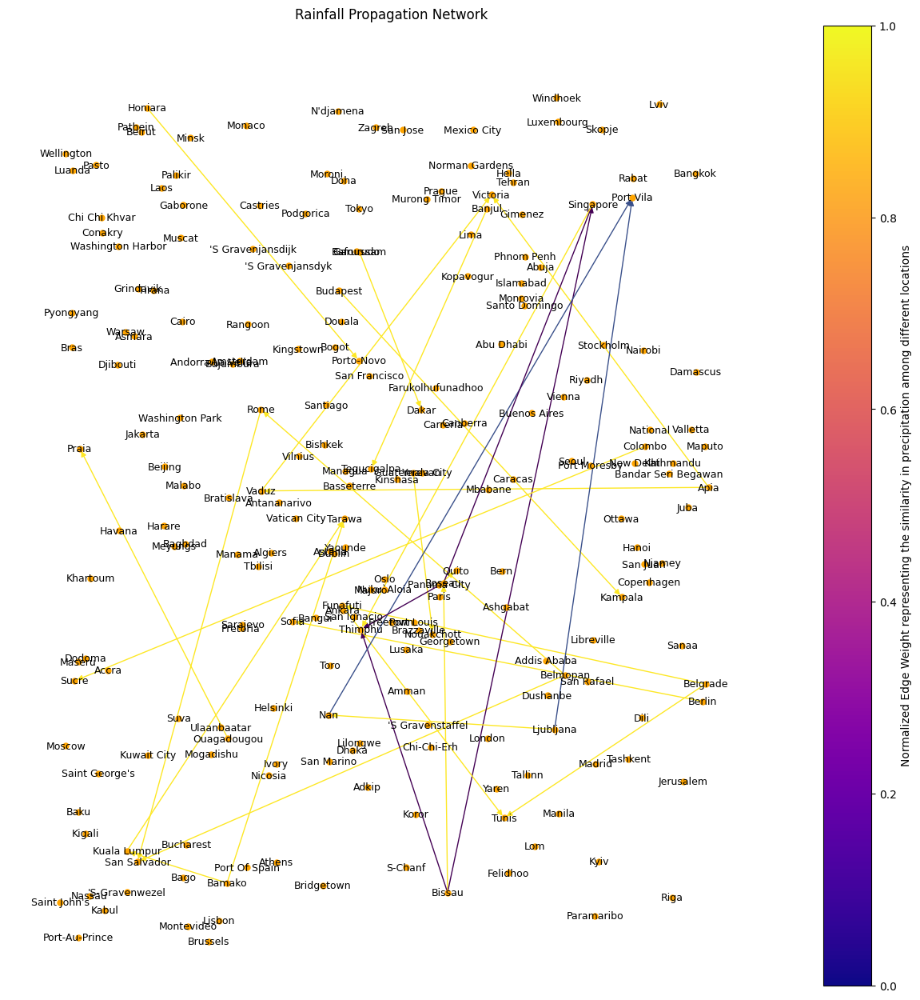

In [ ]:
rainfall_graph_per_month(month_to_df_map[8])

(197, 5)
0.9996585865483101 0.950413223140496


/usr/local/lib/python3.10/dist-packages/networkx/drawing/nx_pylab.py:437: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

<ipython-input-167-4dd079ae5b05>:74: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



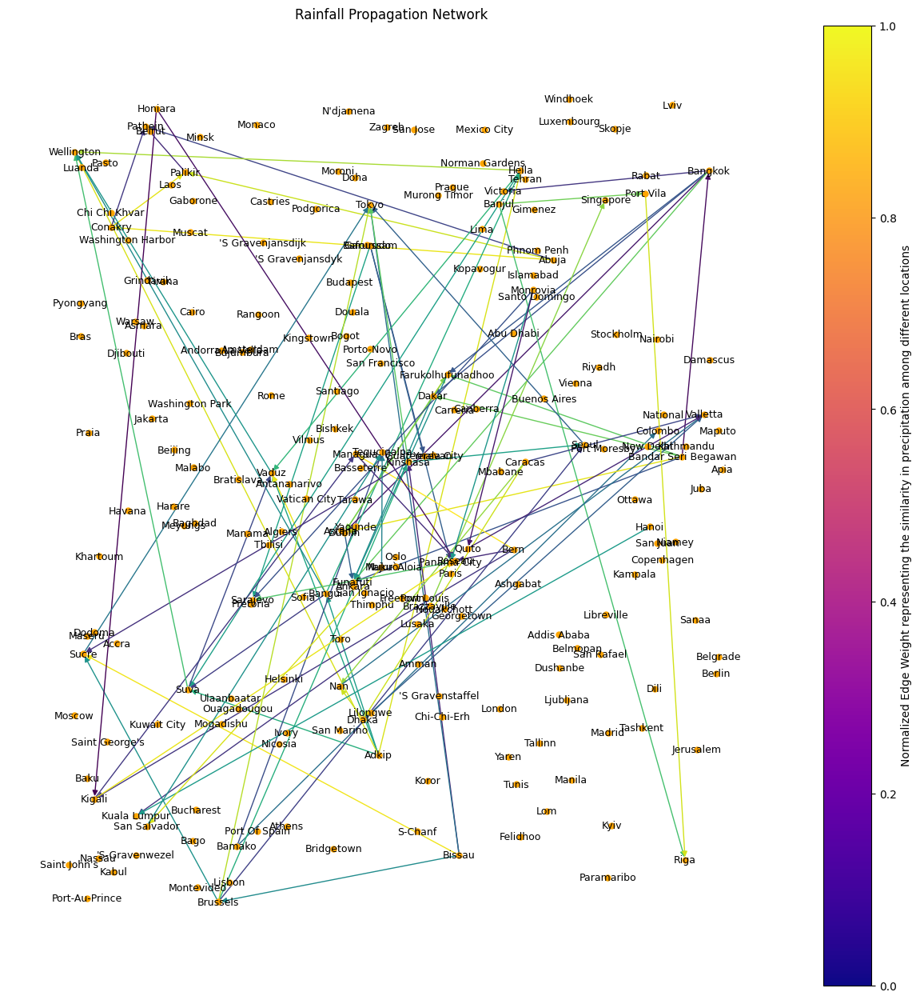

In [ ]:
rainfall_graph_per_month(month_to_df_map[9])

(195, 5)
0.9999999999999998 0.9811046511627908


/usr/local/lib/python3.10/dist-packages/networkx/drawing/nx_pylab.py:437: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

<ipython-input-148-47f7fb333441>:74: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



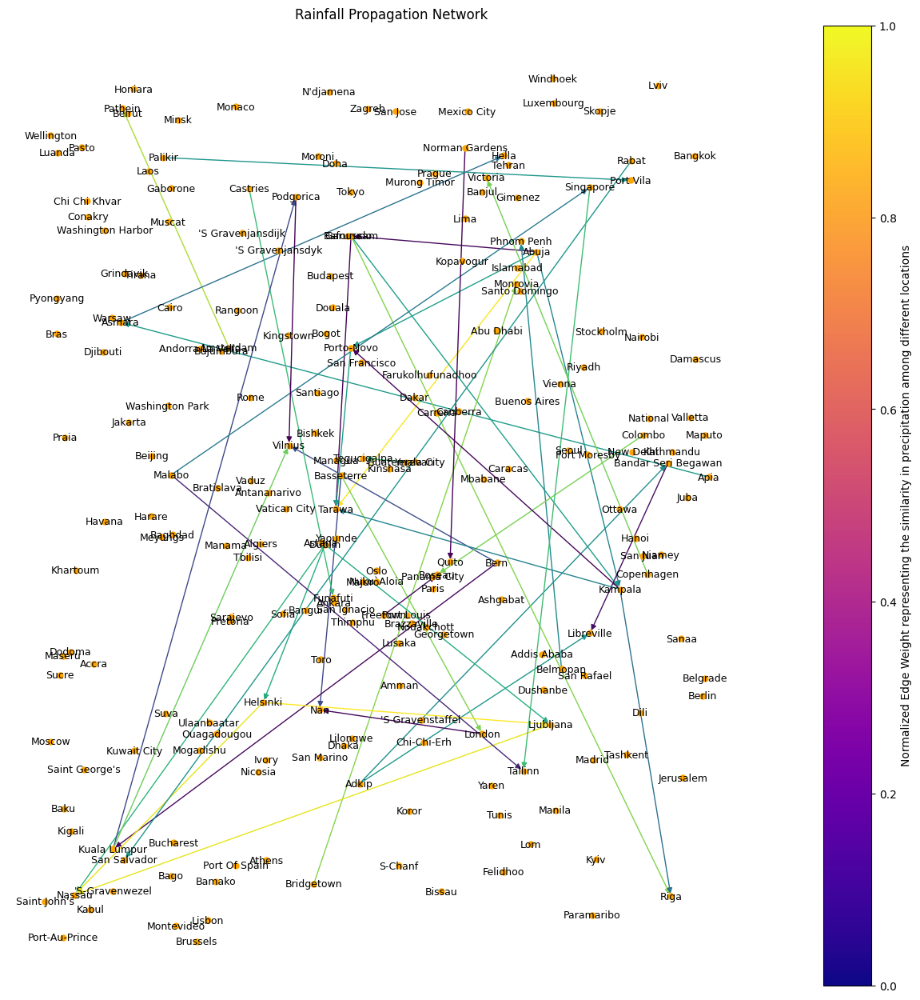

In [ ]:
rainfall_graph_per_month(month_to_df_map[10])

(195, 5)
0.9986684420772304 0.9803063457330417


/usr/local/lib/python3.10/dist-packages/networkx/drawing/nx_pylab.py:437: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

<ipython-input-148-47f7fb333441>:74: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



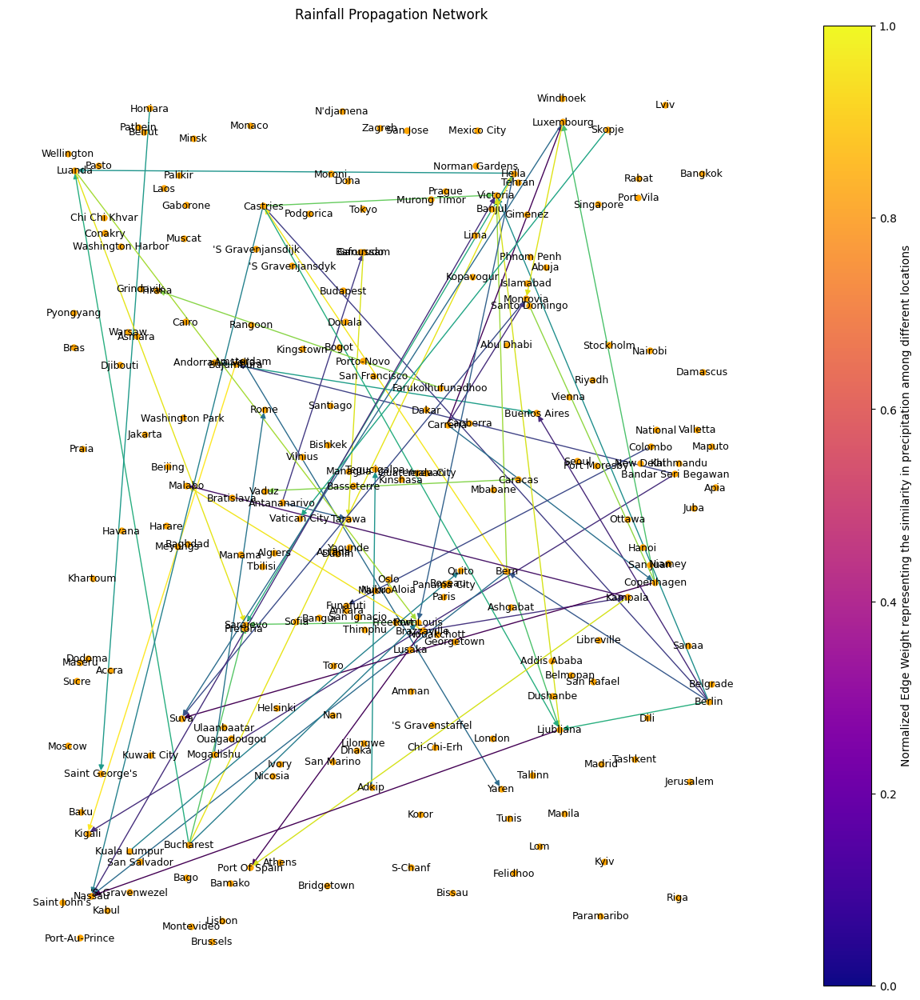

In [ ]:
rainfall_graph_per_month(month_to_df_map[11])

(195, 5)
1.0 0.9811320754716981


/usr/local/lib/python3.10/dist-packages/networkx/drawing/nx_pylab.py:437: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

<ipython-input-148-47f7fb333441>:74: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



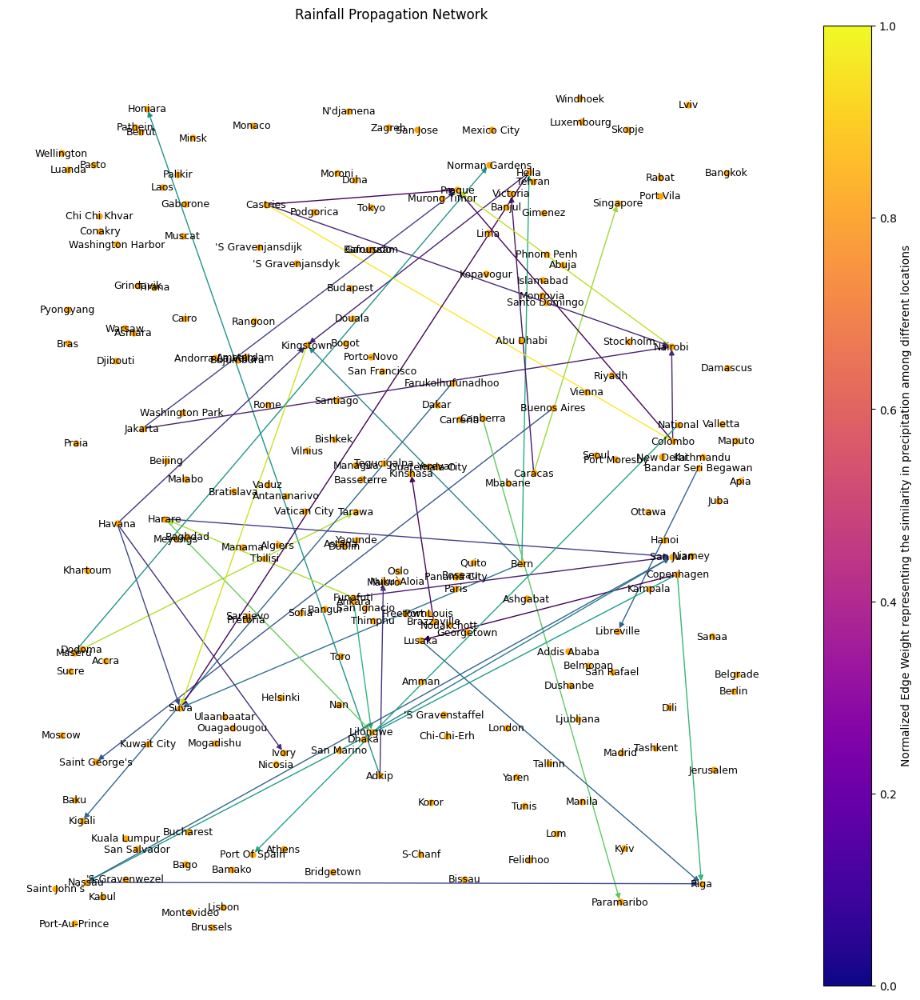

In [ ]:
rainfall_graph_per_month(month_to_df_map[12])

(218, 5)
0.9999999999999999 0.9806701030927834


/usr/local/lib/python3.10/dist-packages/networkx/drawing/nx_pylab.py:437: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

<ipython-input-148-47f7fb333441>:74: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



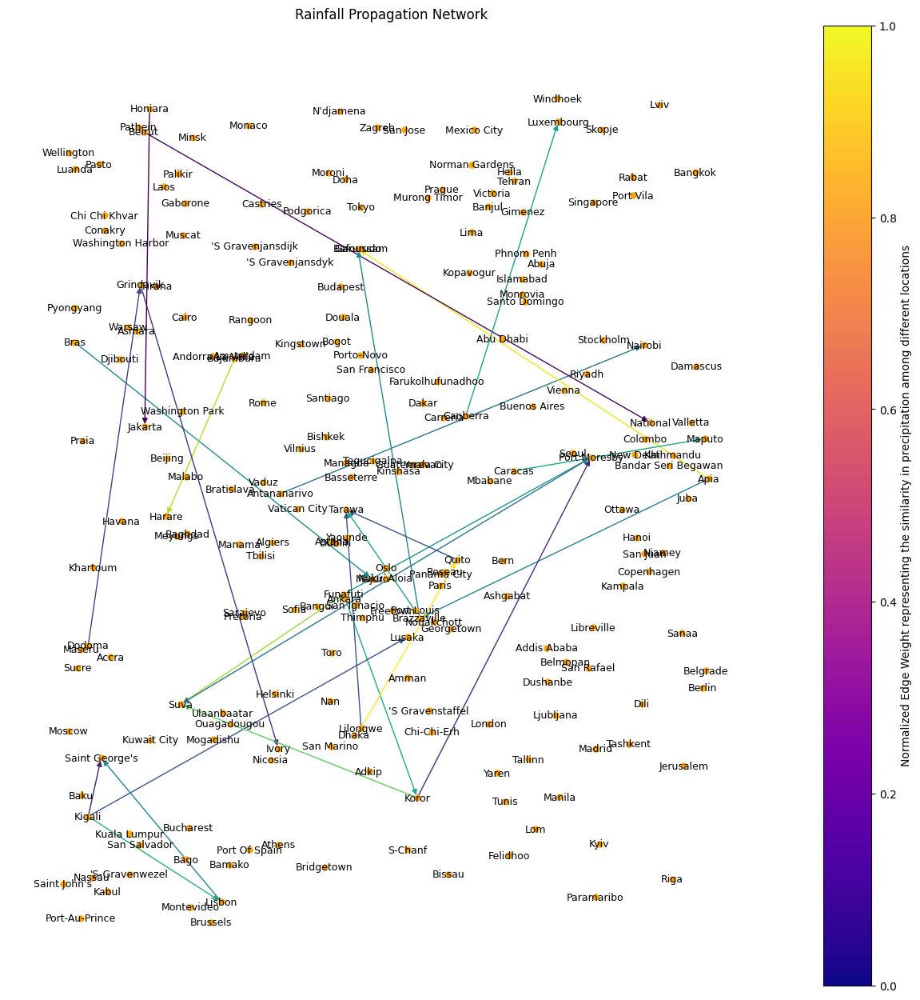

In [ ]:
rainfall_graph_per_month(month_to_df_map[1])

(216, 5)
1.0 0.9802610463250241


/usr/local/lib/python3.10/dist-packages/networkx/drawing/nx_pylab.py:437: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

<ipython-input-148-47f7fb333441>:74: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



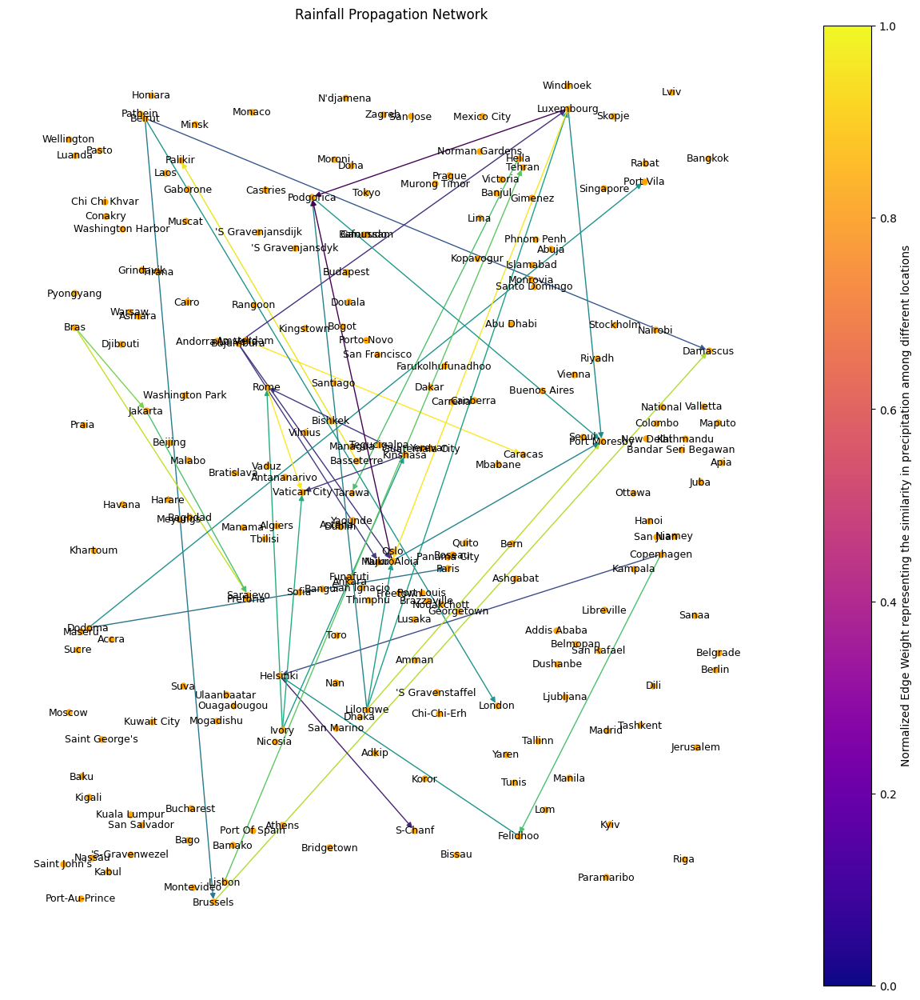

In [ ]:
rainfall_graph_per_month(month_to_df_map[2])

### Rainfall Graph Bi-Weekly (For February)

In [ ]:
def similarity_calculator_3(x, y):
    rainfall_thresh = 0.15
    if x <= rainfall_thresh and y <= rainfall_thresh:
        return 0
    if max(x, y):
        return (1 - abs((x - y)/max(x,y)))
    else:
        return 1

def rainfall_graph_per_week(df):
  avg_rainfall_per_location_df = df.groupby('location_name').agg({'latitude': 'first',  # Assuming latitude is the same for all rows in a location
                                                                'longitude': 'first',  # Assuming longitude is the same for all rows in a location
                                                                'country': 'first',
                                                                'precip_mm': 'mean',
                                                            }).reset_index()
  print(avg_rainfall_per_location_df.shape)

  # Define threshold for precipitation to consider it as rainfall
  precipitation_similarity_threshold = 0.98  # Adjust as needed

  # Create a directed graph
  G = nx.DiGraph()

  for location in locations:
      G.add_node(location)

  for i in range(len(avg_rainfall_per_location_df)):
      for j in range(i + 1, len(avg_rainfall_per_location_df)):
          source_location = avg_rainfall_per_location_df.iloc[i]['location_name']
          source_precipitation = avg_rainfall_per_location_df.iloc[i]['precip_mm']
          target_location = avg_rainfall_per_location_df.iloc[j]['location_name']
          target_precipitation = avg_rainfall_per_location_df.iloc[j]['precip_mm']

          wt = similarity_calculator_3(source_precipitation, target_precipitation)

          if wt >= precipitation_similarity_threshold:
              # Add directed edge from source to target representing rainfall propagation
              G.add_edge(source_location, target_location, weight = wt)

  # Get edge weights
  edge_weights = [G[u][v]['weight'] for u, v in G.edges()]
  print(max(edge_weights), min(edge_weights))

  # Normalize edge weights between 0 and 1
  min_weight = min(edge_weights)
  max_weight = max(edge_weights)

  norm_edge_weights = [(w - min_weight) / (max_weight - min_weight) for w in edge_weights]

  # Create colormap based on edge weights
  cmap = plt.cm.plasma

  # Visualize the subgraph
  pos = nx.random_layout(G, seed = 69)  # Use different layouts

  plt.figure(figsize=(12, 12))
  nx.draw(G, pos, with_labels=True, font_size=9, node_size=25, font_color='black', node_color="orange", edge_color=norm_edge_weights, cmap=cmap, width=1.0)
  plt.title('Rainfall Propagation Network')

  plt.colorbar(plt.cm.ScalarMappable(cmap=cmap), label='Normalized Edge Weight representing the similarity in precipitation among different locations')
  plt.show()

  # # Retrieve connected nodes with their weights
  # connected_nodes_with_weights = []
  # for edge in G.edges(data=True):
  #     source = edge[0]
  #     target = edge[1]
  #     weight = edge[2]['weight']
  #     connected_nodes_with_weights.append((source, target, weight))

  # # Print connected nodes with their weights
  # for source, target, weight in connected_nodes_with_weights:
  #     print(f"From: {source}, To: {target}, Weight: {weight}")

In [ ]:
df_month = month_to_df_map[2]
df_month['Date'] = pd.to_datetime(df['last_updated']).dt.day

df_month.tail(50)

<ipython-input-16-73a205da14b0>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_month['Date'] = pd.to_datetime(df['last_updated']).dt.day


,country,location_name,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,condition_text,...,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination,month,Date
34259,Saint Kitts and Nevis,Basseterre,17.30,-62.72,America/St_Kitts,1708880400,2024-02-25 13:00,28.0,82.4,Partly cloudy,...,1,1,06:32 AM,06:16 PM,07:20 PM,07:15 AM,Waning Gibbous,100,2,25
34260,Saint Lucia,Castries,14.00,-61.00,America/St_Lucia,1708880400,2024-02-25 13:00,30.0,86.0,Partly cloudy,...,1,1,06:23 AM,06:11 PM,07:14 PM,07:06 AM,Waning Gibbous,100,2,25
34261,Saint Vincent and the Grenadines,Kingstown,13.13,-61.22,America/St_Vincent,1708880400,2024-02-25 13:00,30.0,86.0,Partly cloudy,...,1,1,06:23 AM,06:13 PM,07:16 PM,07:07 AM,Waning Gibbous,100,2,25
34262,Samoa,Apia,-13.83,-171.73,Pacific/Apia,1708880400,2024-02-26 06:00,26.0,78.8,Partly cloudy,...,1,1,06:27 AM,06:53 PM,07:24 PM,06:42 AM,Waning Gibbous,100,2,26
34263,San Marino,San Marino,43.93,12.45,Europe/Rome,1708880400,2024-02-25 18:00,10.0,50.0,Clear,...,2,2,06:55 AM,05:53 PM,06:53 PM,07:31 AM,Waning Gibbous,100,2,25
34264,Belgium,'S-Gravenwezel,51.27,4.55,Europe/Brussels,1708880400,2024-02-25 18:00,8.0,46.4,Partly cloudy,...,1,1,07:08 AM,05:59 PM,07:01 PM,07:45 AM,Waning Gibbous,100,2,25
34265,Saudi Arabia,Riyadh,24.64,46.77,Asia/Riyadh,1708880400,2024-02-25 20:00,19.0,66.2,Clear,...,2,3,06:19 AM,05:53 PM,06:44 PM,06:53 AM,Waning Gibbous,100,2,25
34266,Senegal,Dakar,14.67,-17.44,Africa/Dakar,1708880400,2024-02-25 17:00,25.0,77.0,Sunny,...,4,10,07:29 AM,07:17 PM,08:14 PM,08:08 AM,Waning Gibbous,100,2,25
34267,Serbia,Belgrade,44.80,20.47,Europe/Belgrade,1708880400,2024-02-25 18:00,15.0,59.0,Partly cloudy,...,1,1,06:24 AM,05:20 PM,06:19 PM,07:00 AM,Waning Gibbous,100,2,25
34268,Seychelles Islands,Victoria,-4.62,55.45,Indian/Mahe,1708880400,2024-02-25 21:00,27.0,80.6,Partly cloudy,...,1,1,06:25 AM,06:37 PM,07:23 PM,06:57 AM,Waning Gibbous,100,2,25


In [ ]:
biweek_to_df_map = {}

biweek_to_df_map[0] = df_month[df_month['Date'] <= 4]
biweek_to_df_map[1] = df_month[df_month['Date'] <= 7]
biweek_to_df_map[2] = df_month[df_month['Date'] <= 11]
biweek_to_df_map[3] = df_month[df_month['Date'] <= 14]
biweek_to_df_map[4] = df_month[df_month['Date'] <= 18]
biweek_to_df_map[5] = df_month[df_month['Date'] <= 21]
biweek_to_df_map[6] = df_month[df_month['Date'] <= 25]

(209, 5)
1.0 0.9811320754716981


/usr/local/lib/python3.10/dist-packages/networkx/drawing/nx_pylab.py:437: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

<ipython-input-156-ff337ed8af01>:60: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



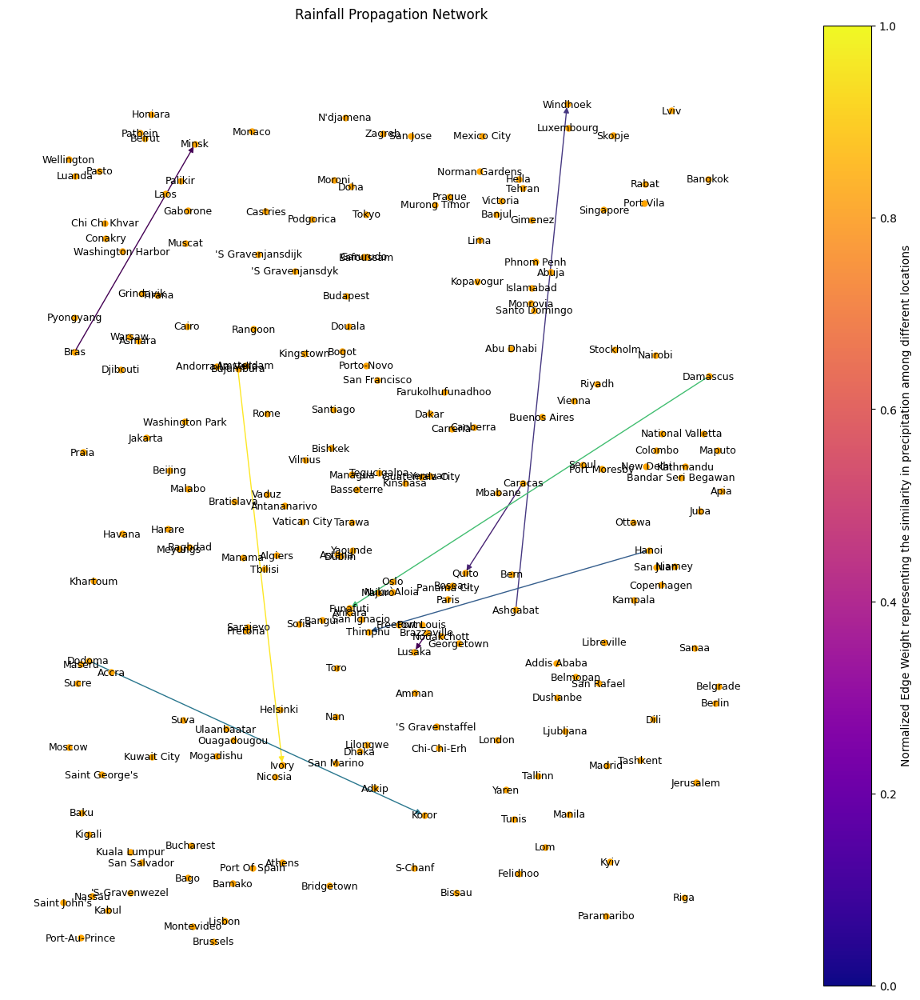

In [ ]:
rainfall_graph_per_week(biweek_to_df_map[0])

(211, 5)
1.0 0.9827586206896551


/usr/local/lib/python3.10/dist-packages/networkx/drawing/nx_pylab.py:437: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

<ipython-input-156-ff337ed8af01>:60: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



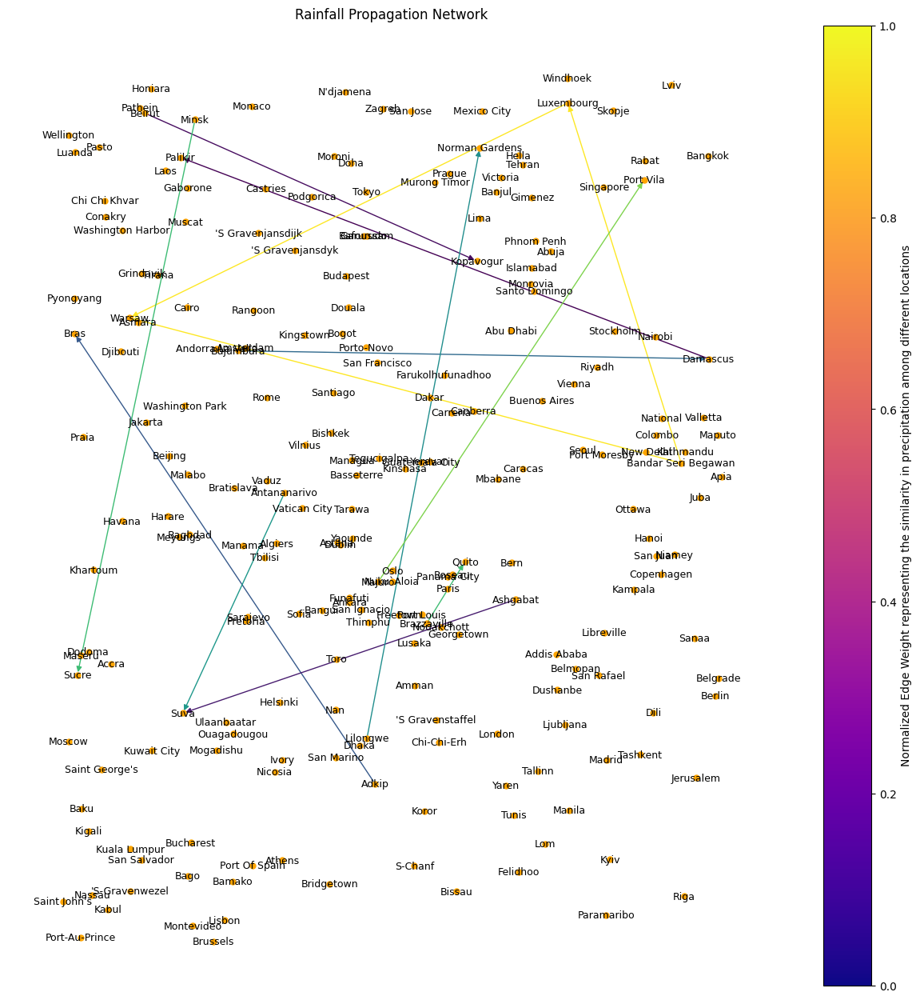

In [ ]:
rainfall_graph_per_week(biweek_to_df_map[1])

(212, 5)
1.0 0.9821428571428571


/usr/local/lib/python3.10/dist-packages/networkx/drawing/nx_pylab.py:437: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

<ipython-input-156-ff337ed8af01>:60: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



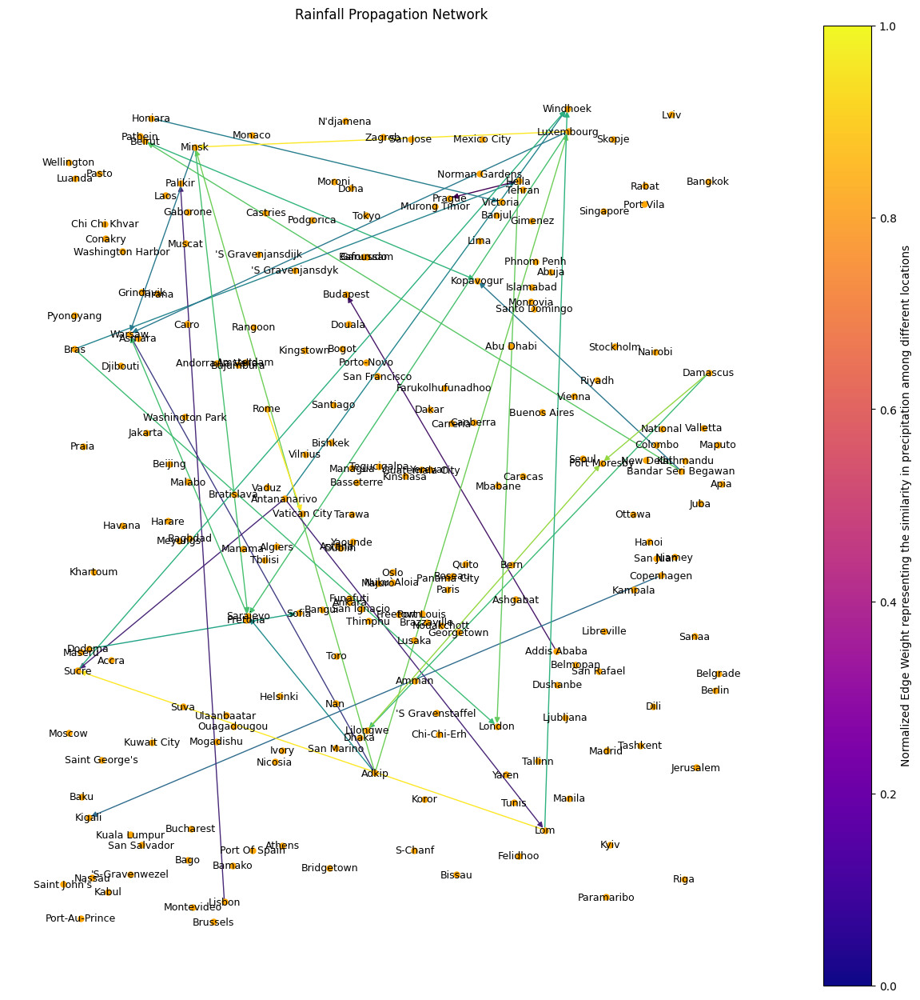

In [ ]:
rainfall_graph_per_week(biweek_to_df_map[2])

(215, 5)
1.0 0.9805054151624548


/usr/local/lib/python3.10/dist-packages/networkx/drawing/nx_pylab.py:437: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

<ipython-input-156-ff337ed8af01>:60: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



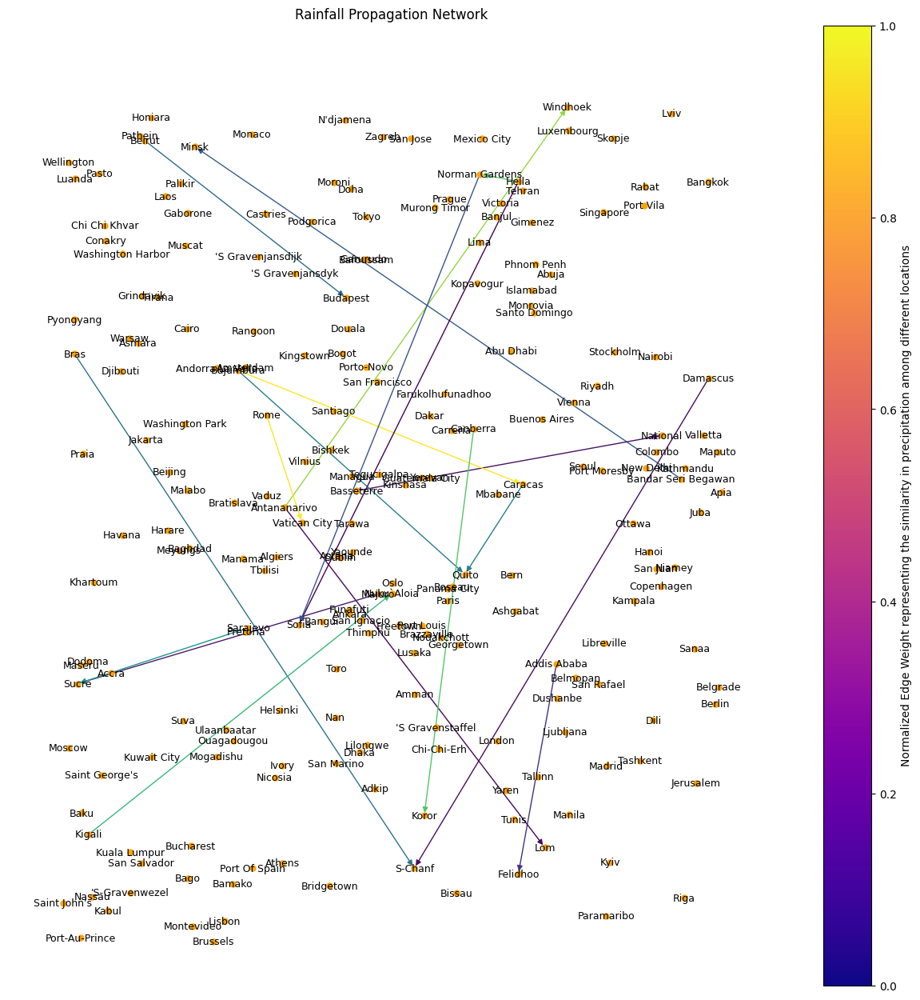

In [ ]:
rainfall_graph_per_week(biweek_to_df_map[3])

(216, 5)
1.0 0.9806451612903225


/usr/local/lib/python3.10/dist-packages/networkx/drawing/nx_pylab.py:437: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

<ipython-input-156-ff337ed8af01>:60: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



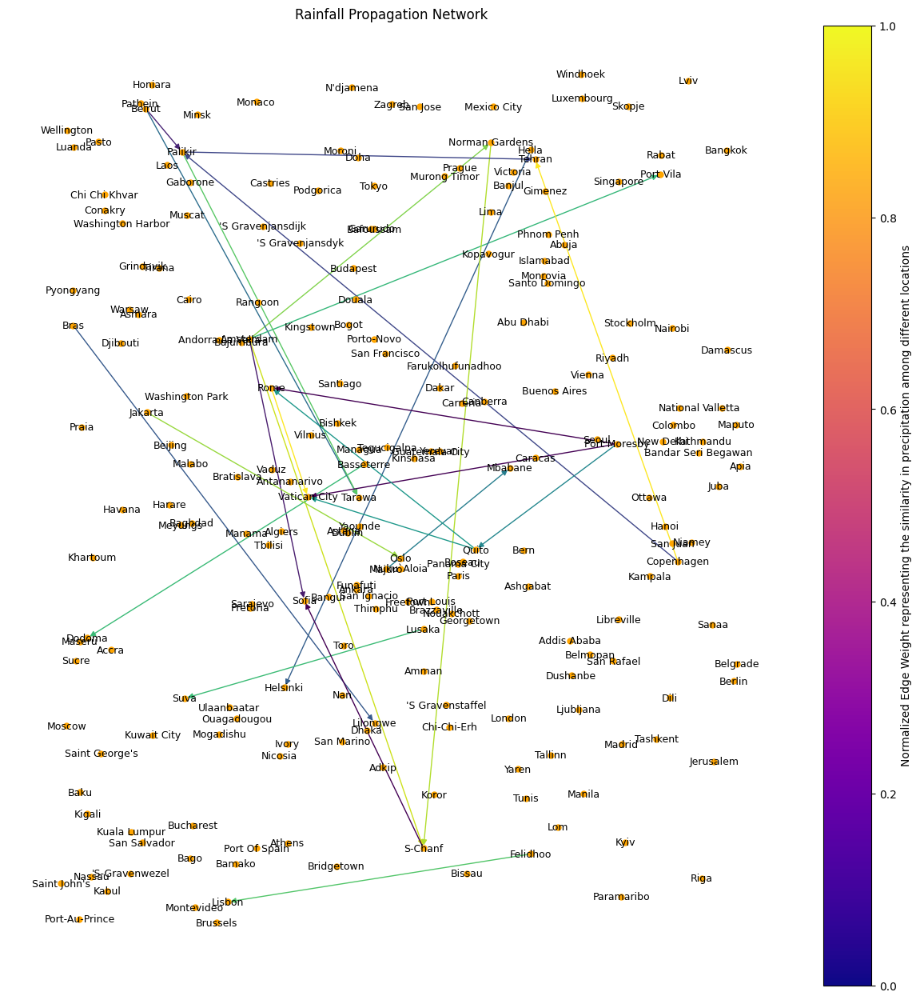

In [ ]:
rainfall_graph_per_week(biweek_to_df_map[4])

(216, 5)
1.0 0.9800000000000001


/usr/local/lib/python3.10/dist-packages/networkx/drawing/nx_pylab.py:437: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

<ipython-input-156-ff337ed8af01>:60: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



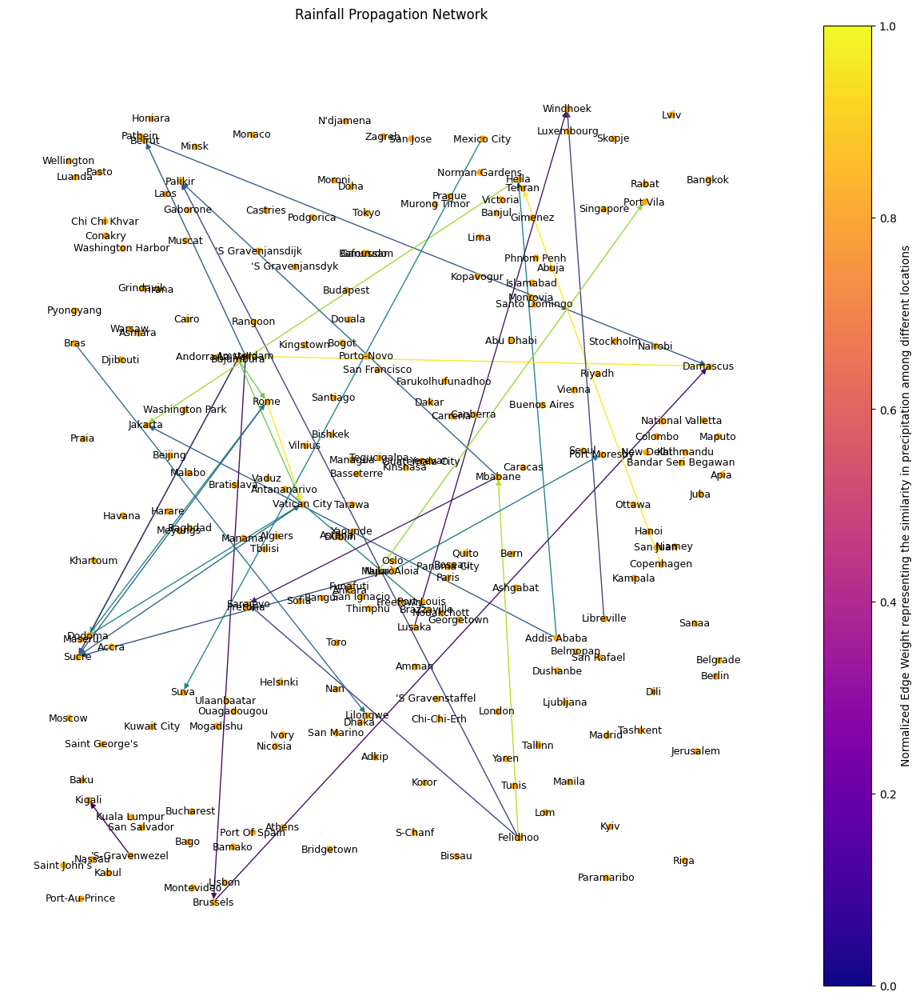

In [ ]:
rainfall_graph_per_week(biweek_to_df_map[5])

In [ ]:
rainfall_graph_per_week(biweek_to_df_map[6])